## Image segmentation

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Import libraries

In [ ]:
from __future__ import absolute_import, division, print_function, unicode_literals

import tensorflow as tf
import keras
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D, UpSampling2D, concatenate
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import Input
from tensorflow.keras import Model
from tensorflow.keras.optimizers import Adam

import pydot
import glob
import matplotlib.pyplot as plt
import numpy

print(tf.__version__)

2.2.0


Using TensorFlow backend.


In [ ]:
DATA_PATH = './drive/My Drive/Datasets/images/Septum'
DATA_TRAIN_PATH = DATA_PATH+'/train'
DATA_TEST_PATH = DATA_PATH+'/test'
FRAMES = '_frames'
MASKS  = '_masks'

Setting training constants

In [ ]:
SEED = 42
batch_size = 32
IMG_HEIGHT = 256
IMG_WIDTH = 256

Definini data generators

In [ ]:
train_frames_generator = ImageDataGenerator(rescale=1./255, rotation_range=10) 
train_masks_generator = ImageDataGenerator(rescale=1./255, rotation_range=10) 

test_frames_generator = ImageDataGenerator(rescale=1./255) 
test_masks_generator = ImageDataGenerator(rescale=1./255) 


train_frames_gata_gen = train_frames_generator.flow_from_directory(DATA_TRAIN_PATH + FRAMES, batch_size=batch_size,
                                                    class_mode=None, seed=SEED, color_mode='grayscale')

train_masks_gata_gen = train_masks_generator.flow_from_directory(DATA_TRAIN_PATH + MASKS, batch_size=batch_size,
                                                    class_mode=None, seed=SEED, color_mode='grayscale')

test_frames_gata_gen = test_frames_generator.flow_from_directory(DATA_TEST_PATH + FRAMES, batch_size=batch_size,
                                                    class_mode=None, seed=SEED, color_mode='grayscale')

test_masks_gata_gen = test_masks_generator.flow_from_directory(DATA_TEST_PATH + MASKS, batch_size=batch_size,
                                                    class_mode=None, seed=SEED, color_mode='grayscale')

train_generator = zip(train_frames_gata_gen, train_masks_gata_gen)
test_generator = zip(test_frames_gata_gen, test_masks_gata_gen)

Found 227 images belonging to 1 classes.
Found 227 images belonging to 1 classes.
Found 74 images belonging to 1 classes.
Found 74 images belonging to 1 classes.


Cheking data generators

In [ ]:
train_frames, train_masks = next(train_generator)
print(len(train_frames))

32


In [ ]:
def plotImages(frames_arr, masks_arr):
    fig, ax = plt.subplots(len(frames_arr), 2, figsize=(10, 20))
    for i in range(len(frames_arr)):
      ax[i, 0].imshow(frames_arr[i][:, :, 0], cmap=plt.cm.gray)
      ax[i, 1].imshow(masks_arr[i][:, :, 0], cmap=plt.cm.gray)
    plt.tight_layout()
    plt.show()

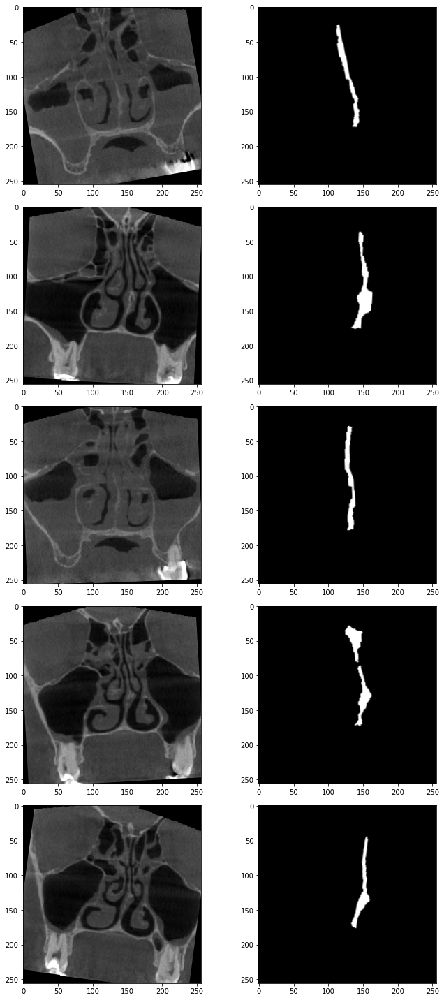

In [ ]:
plotImages(train_frames[:5], train_masks[:5]) 

Cheking GPU


In [ ]:
import os
from tensorflow.python.client import device_lib

print(device_lib.list_local_devices())
os.environ["CUDA_VISIBLE_DEVICES"] = "1"

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 11974392831029014767
, name: "/device:XLA_CPU:0"
device_type: "XLA_CPU"
memory_limit: 17179869184
locality {
}
incarnation: 10213064543958117127
physical_device_desc: "device: XLA_CPU device"
, name: "/device:XLA_GPU:0"
device_type: "XLA_GPU"
memory_limit: 17179869184
locality {
}
incarnation: 10383107894350125140
physical_device_desc: "device: XLA_GPU device"
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 7304675328
locality {
  bus_id: 1
  links {
  }
}
incarnation: 972130069633953316
physical_device_desc: "device: 0, name: Tesla P4, pci bus id: 0000:00:04.0, compute capability: 6.1"
]


Neural net

In [ ]:
OUTPUT_CHANNELS = 1

def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
       tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())

    result.add(tf.keras.layers.LeakyReLU())

    return result

def upsample(filters, size, name, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
       tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

    result.add(tf.keras.layers.BatchNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    result.add(tf.keras.layers.ReLU())

    return result

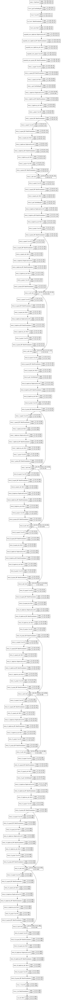

In [ ]:
base_model = tf.keras.applications.MobileNetV2(input_shape=[256, 256, 1], include_top=False, weights=None)
tf.keras.utils.plot_model(base_model, show_shapes=True, dpi=64)

In [ ]:
base_model = tf.keras.applications.MobileNetV2(input_shape=[256, 256, 1], include_top=False, weights=None)

# Use the activations of these layers
layer_names = [
    'block_1_expand_relu',   # 128x128
    'block_3_expand_relu',   # 64x64
    'block_6_expand_relu',   # 32x32
    'block_13_expand_relu',  # 16x16
]

layers = [base_model.get_layer(name) for name in layer_names]
print(type(layers[0]))

# Create the feature extraction model
down_stack = base_model
down_stack.trainable = True

<class 'tensorflow.python.keras.layers.advanced_activations.ReLU'>


In [ ]:
up_stack = [
      # upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024)
      upsample(1280, 4, name='8x8', apply_dropout=True), # (bs, 4, 4, 1024)
      upsample(576, 4, name='16x16'), # (bs, 16, 16, 1024)
      upsample(192, 4, name='32x32'), # (bs, 32, 32, 512)
      upsample(144, 4, name='64x64'), # (bs, 64, 64, 256)
      upsample(96, 4, name='128x128'),  # (bs, 128, 128, 128)
    ]

In [ ]:
def Generator(output_channels=1):
  # Downsampling through the model
  x = base_model.output

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack[1:], reversed(layers)):
    x = up(x)
    concat = tf.keras.layers.Concatenate()
    x = concat([x, skip.output])

  # This is the last layer of the model
  last = tf.keras.layers.Conv2DTranspose(
      output_channels, 3, strides=2,
      padding='same')  #128x128 -> 256x256

  x = last(x)

  return tf.keras.Model(inputs=base_model.input, outputs=x)

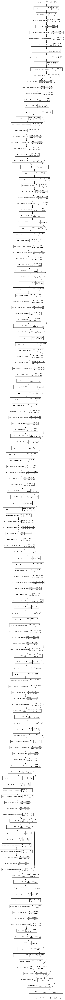

In [ ]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

In [ ]:
generator = tf.keras.models.load_model('./drive/My Drive/Models/model_septum_generator.h5')

In [ ]:
LAMBDA = 100
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

In [ ]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, OUTPUT_CHANNELS], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, OUTPUT_CHANNELS], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar]) # (bs, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x) # (bs, 128, 128, 64)
  down2 = downsample(128, 4)(down1) # (bs, 64, 64, 128)
  down3 = downsample(256, 4)(down2) # (bs, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

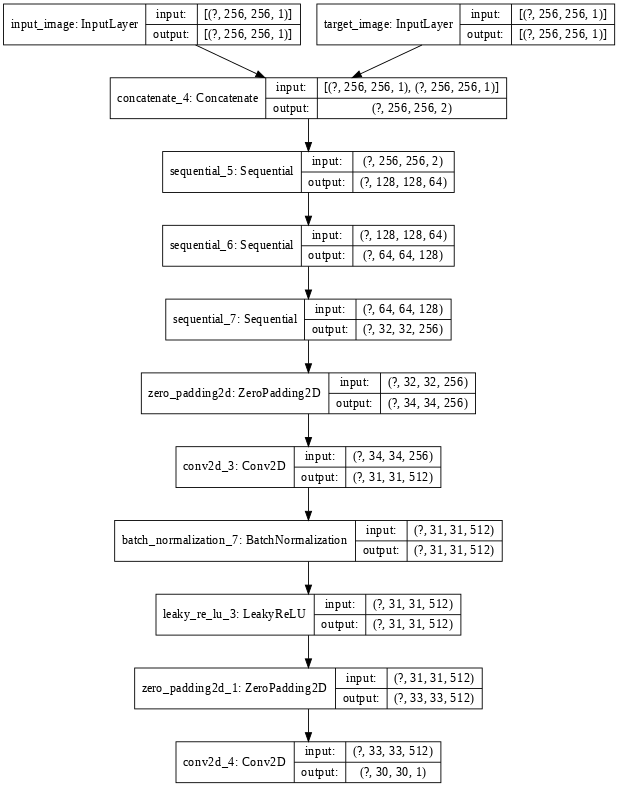

In [ ]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

In [ ]:
discriminator = tf.keras.models.load_model('./drive/My Drive/Models/model_septum_discriminator.h5')

In [ ]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1e-2)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-2)

In [ ]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [ ]:
def generate_images(model, test_input, tar):
  prediction = model(test_input[tf.newaxis, :, :, 0], training=True)
  plt.figure(figsize=(15,15))
  print(prediction.shape)
  display_list = [test_input, tar, prediction[0, :, :, :]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    image = display_list[i]
    if i == 2:
       plt.imshow(image[:, :, 0] , cmap=plt.cm.gray)
    else:
       plt.imshow(image[:, :, 0], cmap=plt.cm.gray)
    plt.axis('off')
  plt.show()

(1, 256, 256, 1)


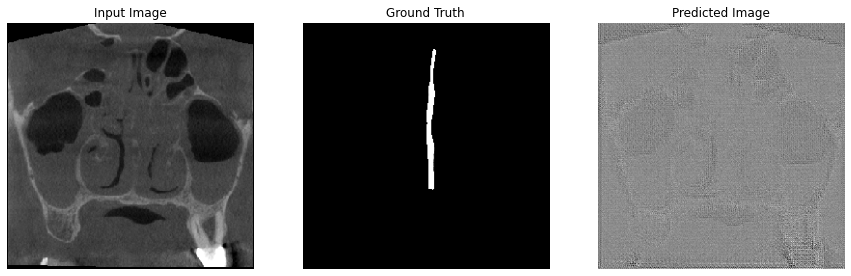

(1, 256, 256, 1)


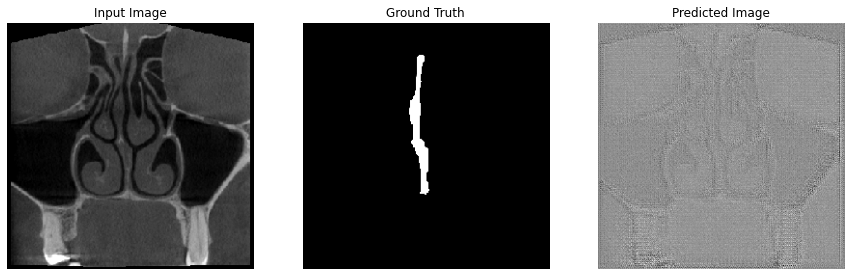

(1, 256, 256, 1)


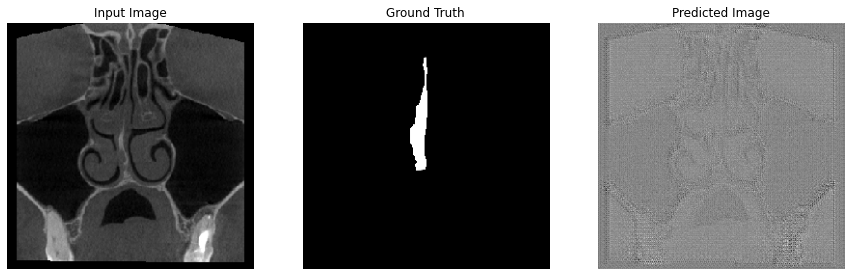

(1, 256, 256, 1)


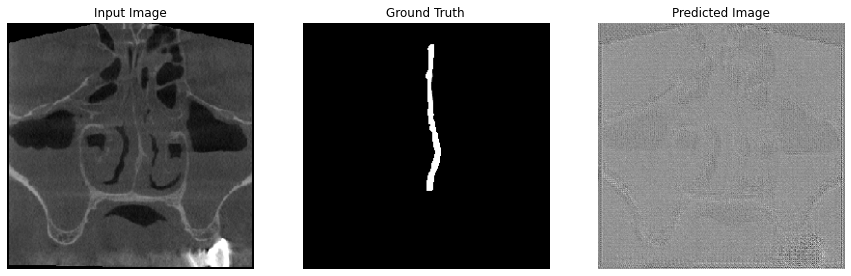

(1, 256, 256, 1)


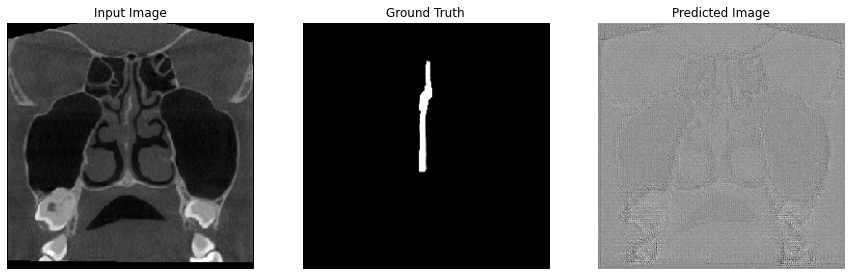

(1, 256, 256, 1)


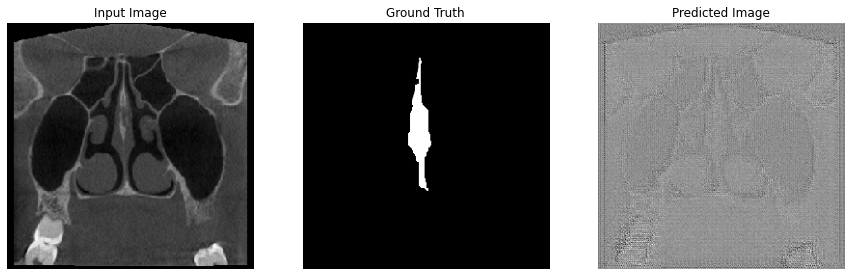

(1, 256, 256, 1)


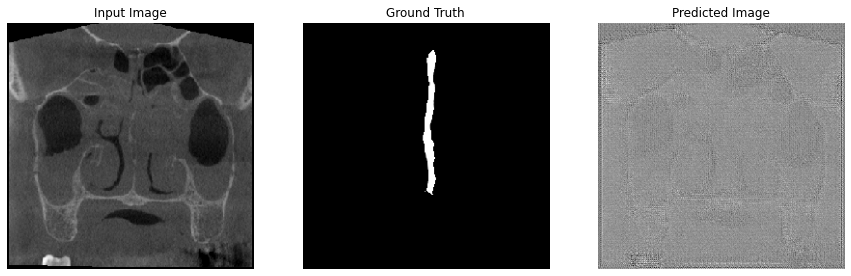

(1, 256, 256, 1)


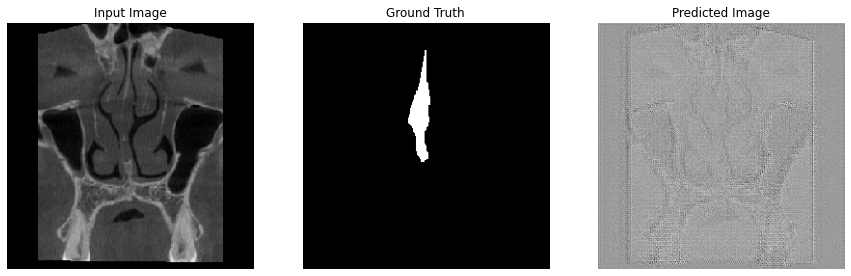

(1, 256, 256, 1)


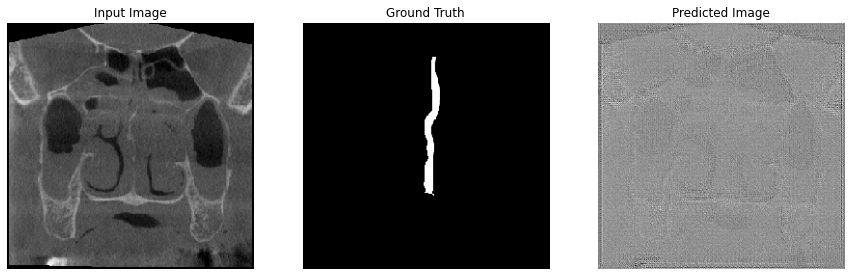

(1, 256, 256, 1)


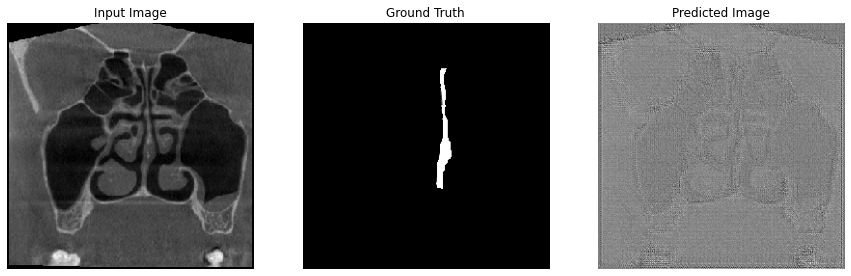

(1, 256, 256, 1)


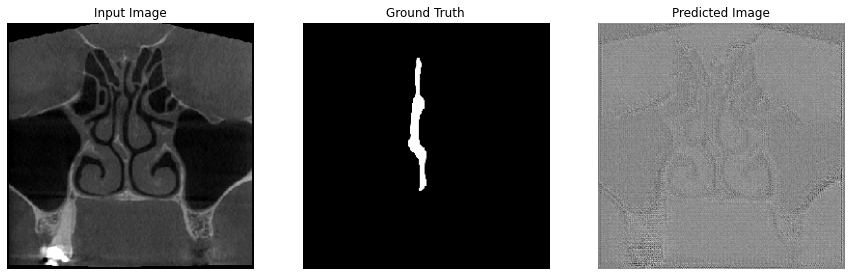

(1, 256, 256, 1)


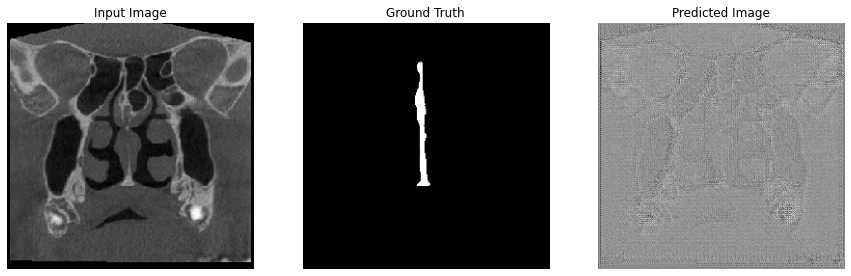

(1, 256, 256, 1)


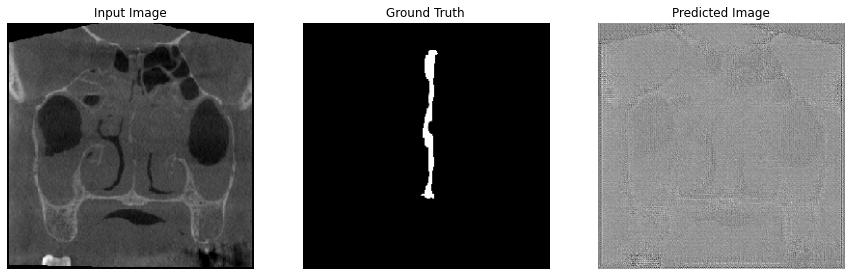

(1, 256, 256, 1)


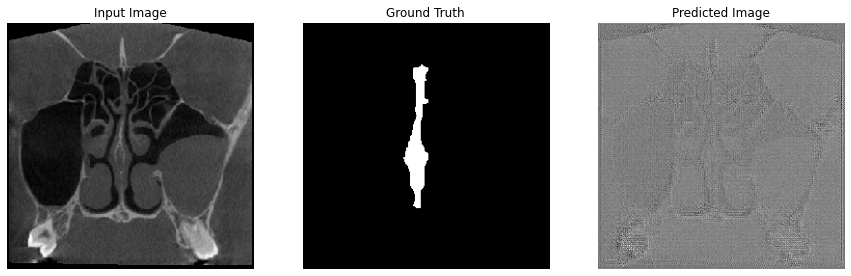

(1, 256, 256, 1)


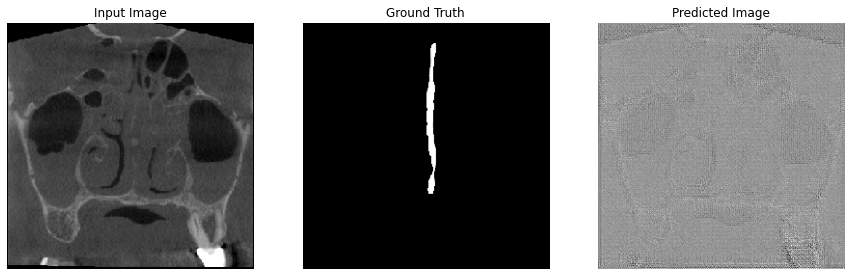

(1, 256, 256, 1)


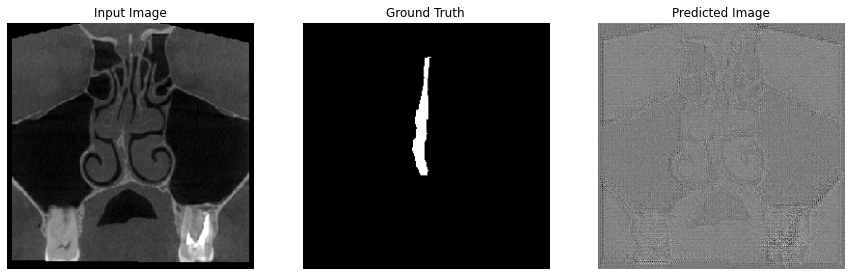

(1, 256, 256, 1)


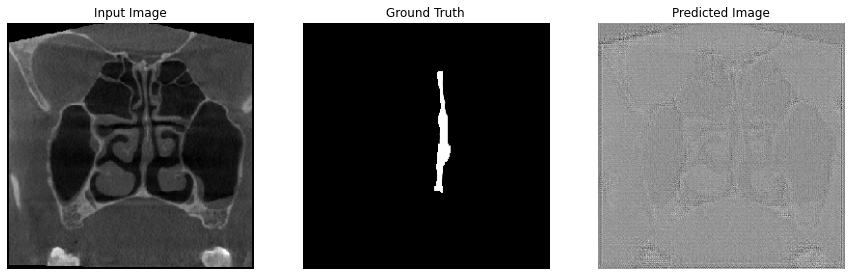

(1, 256, 256, 1)


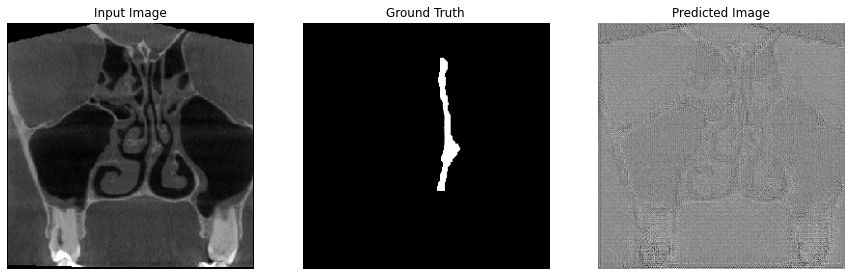

(1, 256, 256, 1)


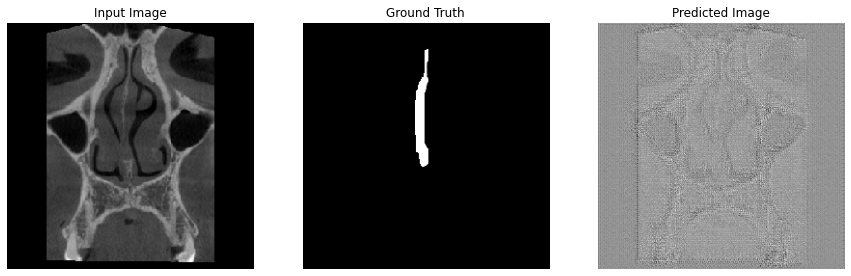

(1, 256, 256, 1)


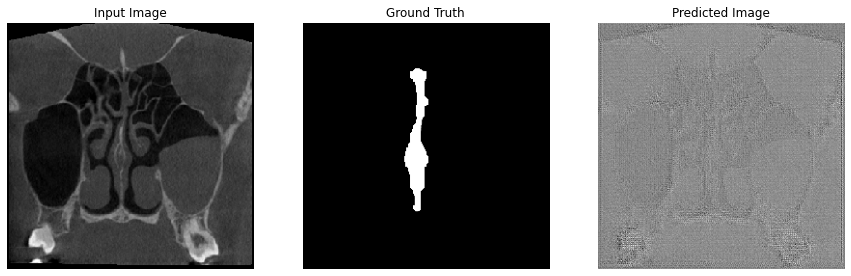

(1, 256, 256, 1)


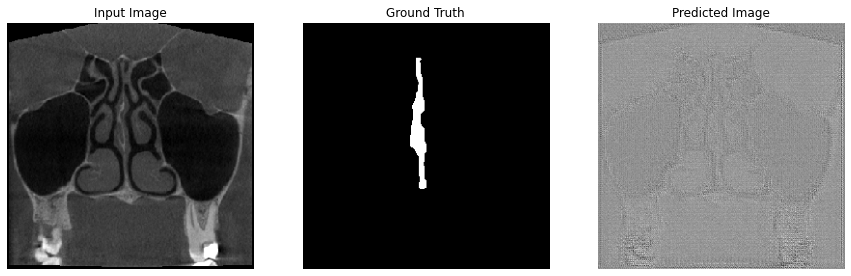

(1, 256, 256, 1)


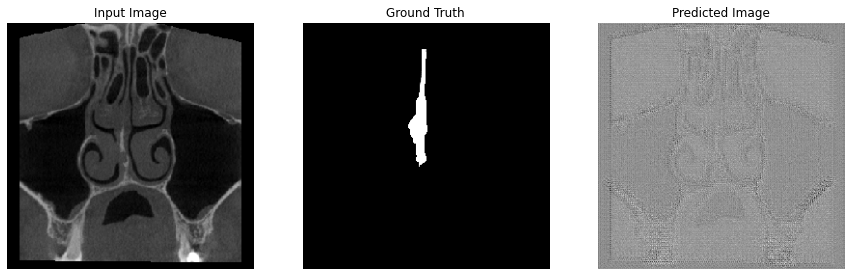

(1, 256, 256, 1)


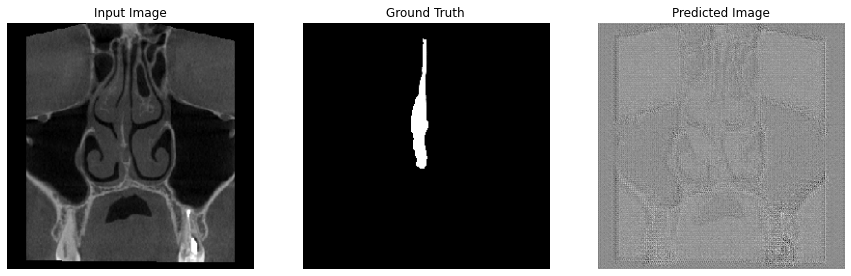

(1, 256, 256, 1)


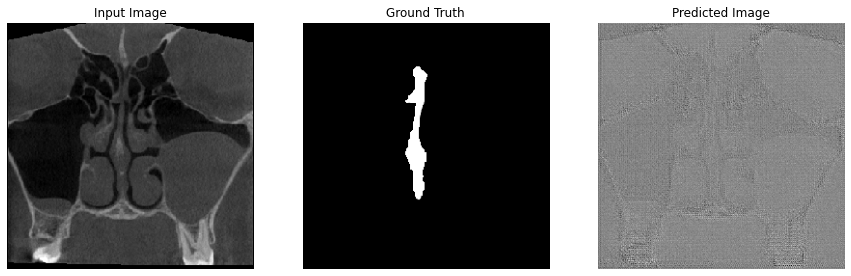

(1, 256, 256, 1)


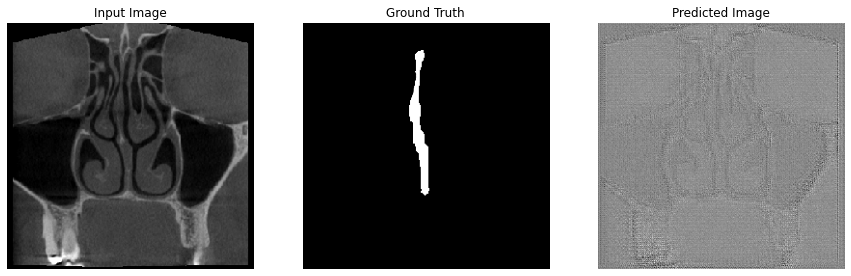

(1, 256, 256, 1)


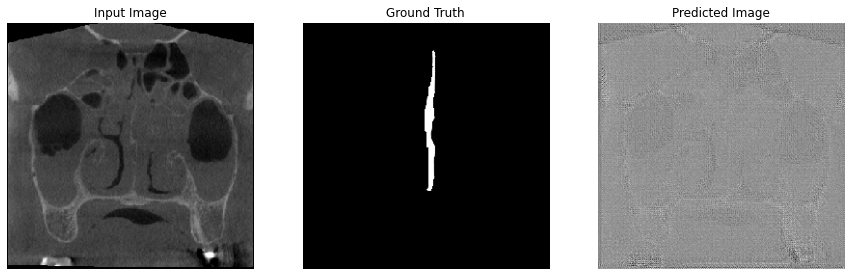

(1, 256, 256, 1)


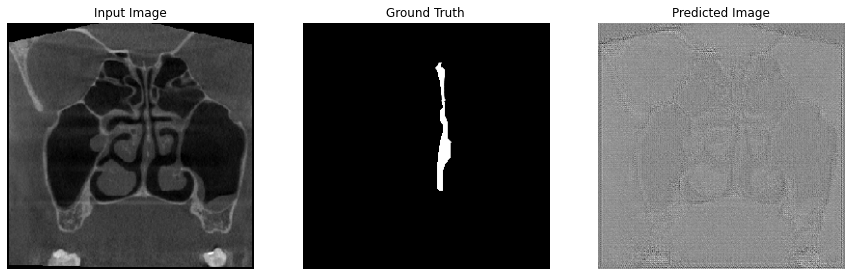

(1, 256, 256, 1)


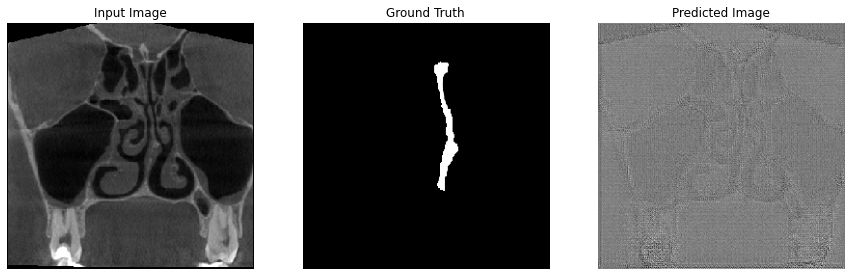

(1, 256, 256, 1)


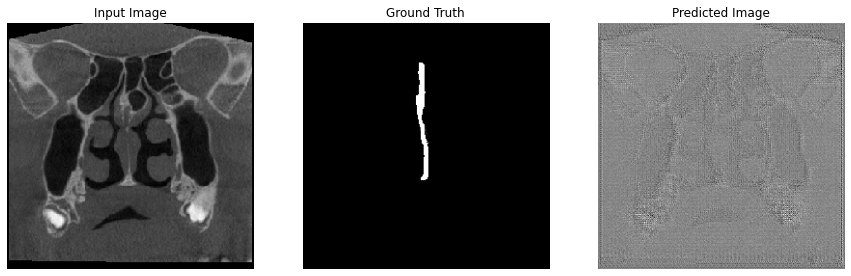

(1, 256, 256, 1)


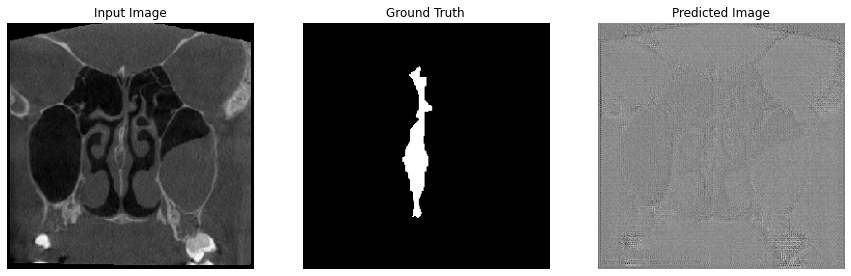

(1, 256, 256, 1)


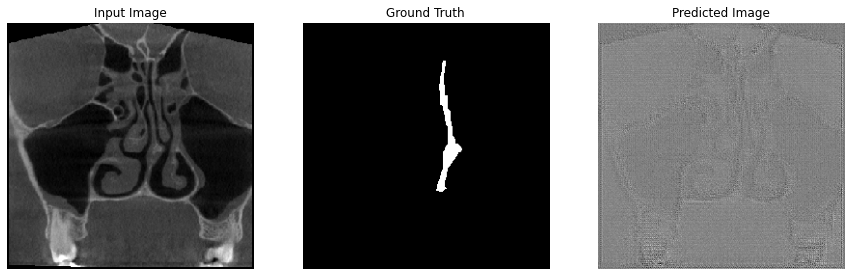

(1, 256, 256, 1)


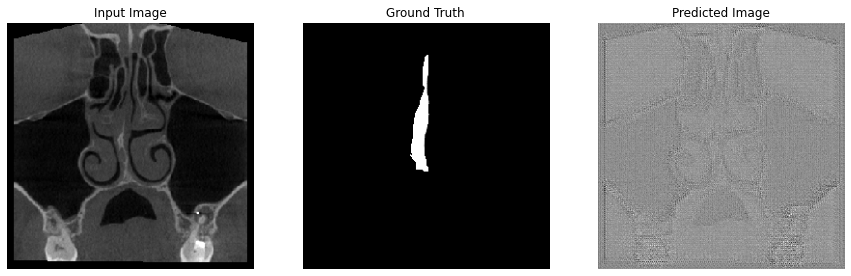

In [ ]:
test_frames, test_masks = next(test_generator)

for frame, mask in zip(test_frames, test_masks):
  generate_images(generator, frame, mask)

In [ ]:
import datetime
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [ ]:
metrics = tf.keras.metrics.MeanIoU(num_classes=2)

Define train functions to train GAN

In [ ]:
@tf.function
def train_step(input_image, target, epoch):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))
  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
    tf.summary.scalar('disc_loss', disc_loss, step=epoch)

  # metrics.update_state(target, generator(input_image, training=True))

In [ ]:
EPOCHS = 100
STEP_PER_EPOCH = 60

In [ ]:
import sys

def fit(epochs, steps_per_epoch, train_generator):
  for epoch in range(epochs):
    start = time.time()

    train_frames, train_masks = next(train_generator)
    generate_images(generator, train_frames[0], train_masks[0])

    n=0
    print("Epoch: ", epoch)
    # Train
    for i in range(steps_per_epoch):
      train_frames, train_masks = next(train_generator)
      train_step(train_frames, train_masks, epoch)
      sys.stdout.write('\r'+"Done {}/{}".format(i, steps_per_epoch))

    print()

    # saving (checkpoint) the model every 20 epochs
    if (epoch + 1) % 4 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))
  checkpoint.save(file_prefix = checkpoint_prefix)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

<IPython.core.display.Javascript object>

Checking train step function

In [ ]:
train_frames, train_masks = next(train_generator)
train_step(train_frames, train_masks, epoch=0)

Train the network

(1, 256, 256, 1)


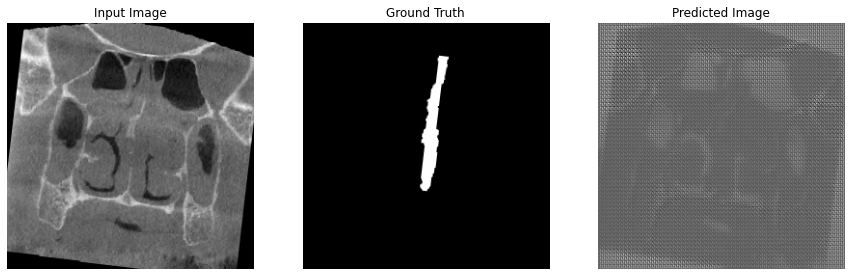

Epoch:  0
Done 59/60
Time taken for epoch 1 is 356.3539528846741 sec

(1, 256, 256, 1)


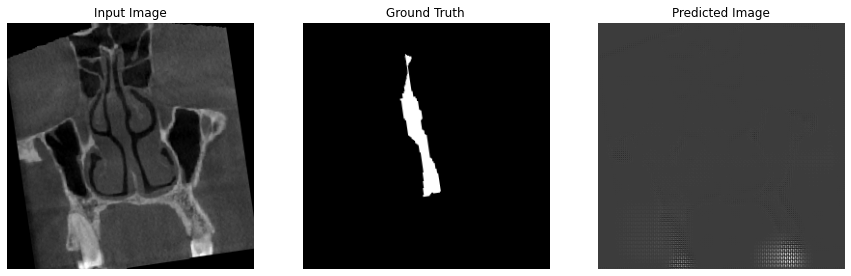

Epoch:  1
Done 59/60
Time taken for epoch 2 is 77.02216243743896 sec

(1, 256, 256, 1)


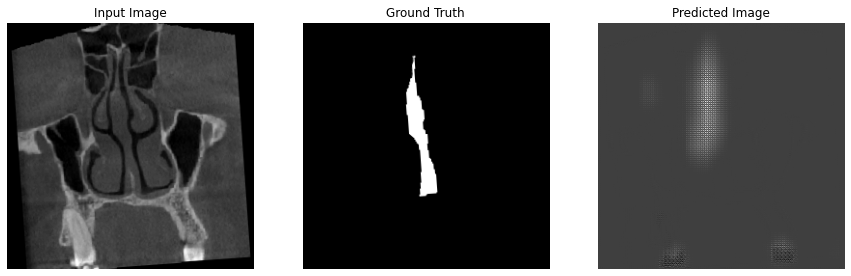

Epoch:  2
Done 59/60
Time taken for epoch 3 is 75.5463182926178 sec

(1, 256, 256, 1)


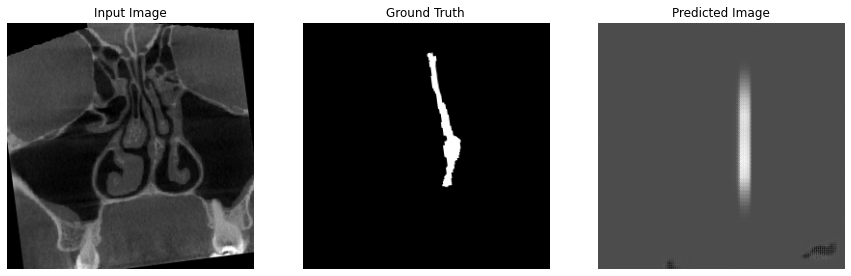

Epoch:  3
Done 59/60
Time taken for epoch 4 is 79.42469072341919 sec

(1, 256, 256, 1)


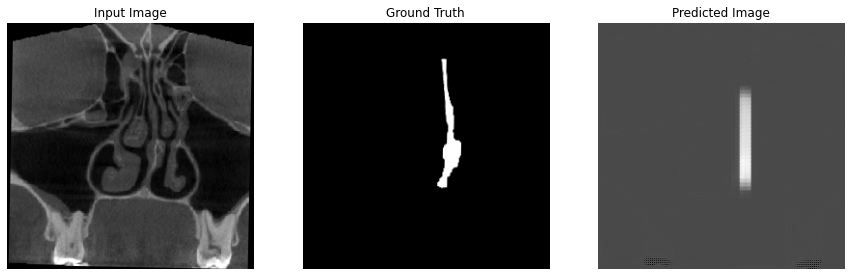

Epoch:  4
Done 59/60
Time taken for epoch 5 is 77.00848078727722 sec

(1, 256, 256, 1)


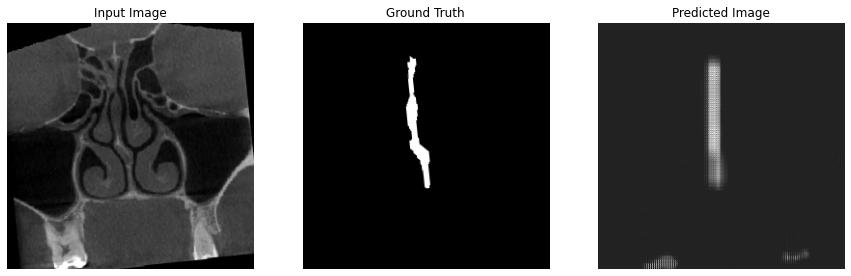

Epoch:  5
Done 59/60
Time taken for epoch 6 is 76.69795894622803 sec

(1, 256, 256, 1)


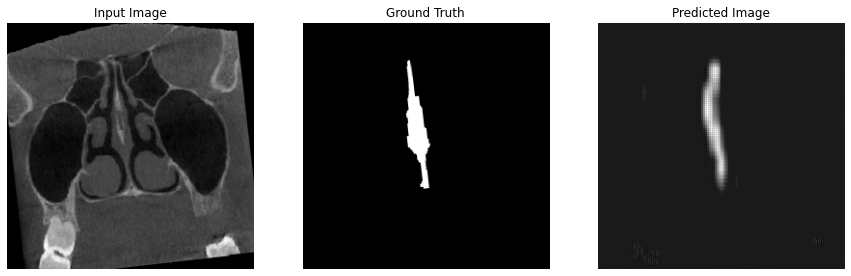

Epoch:  6
Done 59/60
Time taken for epoch 7 is 76.97080326080322 sec

(1, 256, 256, 1)


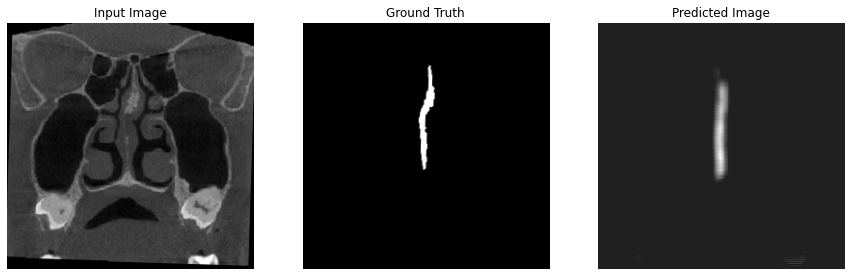

Epoch:  7
Done 59/60
Time taken for epoch 8 is 78.73106145858765 sec

(1, 256, 256, 1)


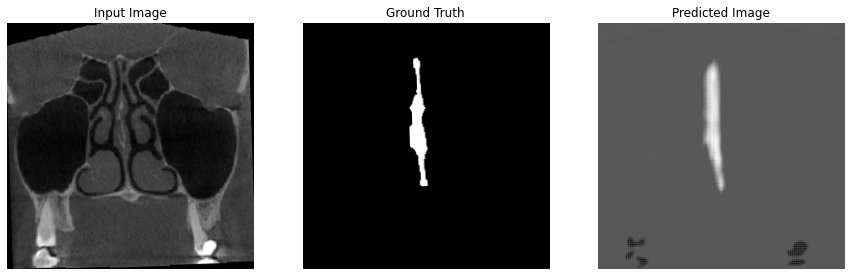

Epoch:  8
Done 59/60
Time taken for epoch 9 is 77.28848361968994 sec

(1, 256, 256, 1)


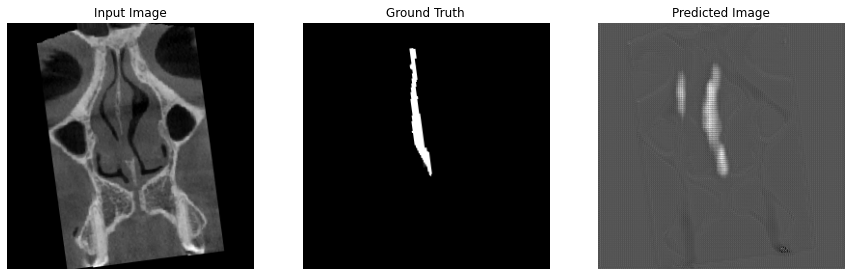

Epoch:  9
Done 59/60
Time taken for epoch 10 is 77.39803409576416 sec

(1, 256, 256, 1)


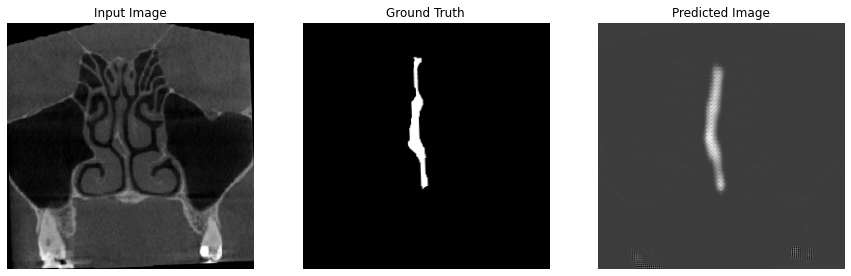

Epoch:  10
Done 59/60
Time taken for epoch 11 is 77.83285212516785 sec

(1, 256, 256, 1)


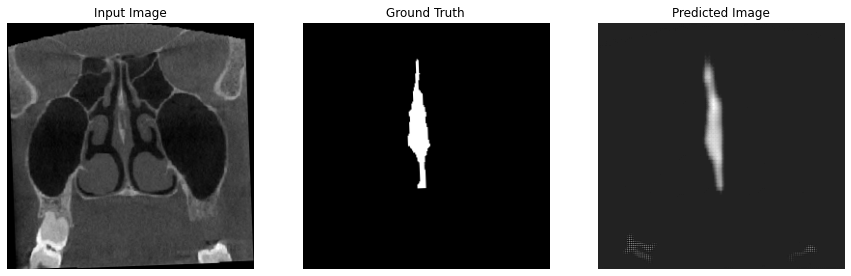

Epoch:  11
Done 59/60
Time taken for epoch 12 is 79.1660041809082 sec

(1, 256, 256, 1)


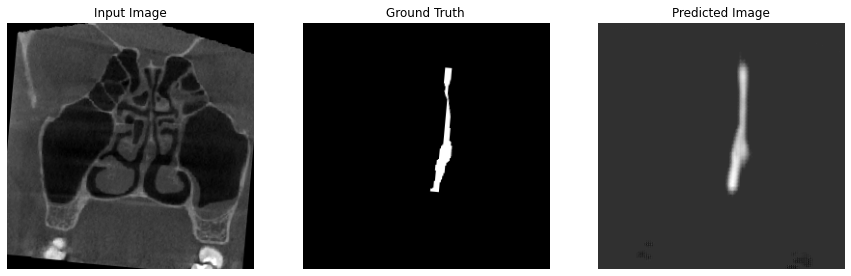

Epoch:  12
Done 59/60
Time taken for epoch 13 is 76.99012589454651 sec

(1, 256, 256, 1)


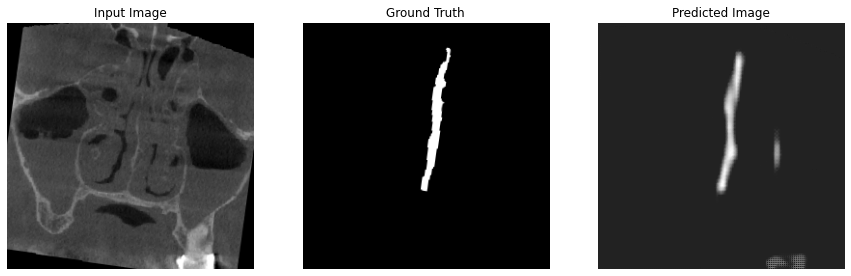

Epoch:  13
Done 59/60
Time taken for epoch 14 is 77.9860098361969 sec

(1, 256, 256, 1)


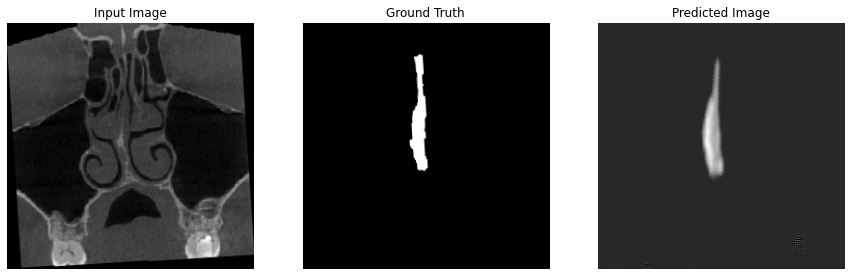

Epoch:  14
Done 59/60
Time taken for epoch 15 is 76.28982448577881 sec

(1, 256, 256, 1)


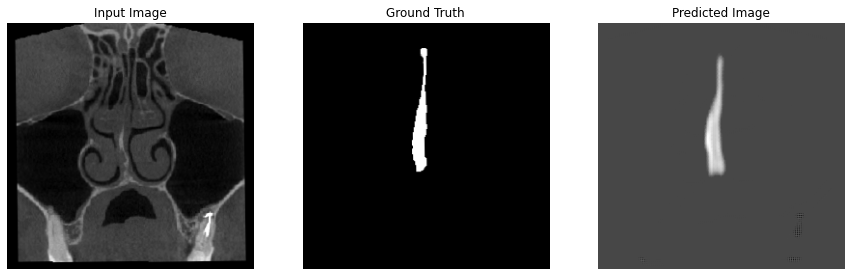

Epoch:  15
Done 59/60
Time taken for epoch 16 is 78.29473662376404 sec

(1, 256, 256, 1)


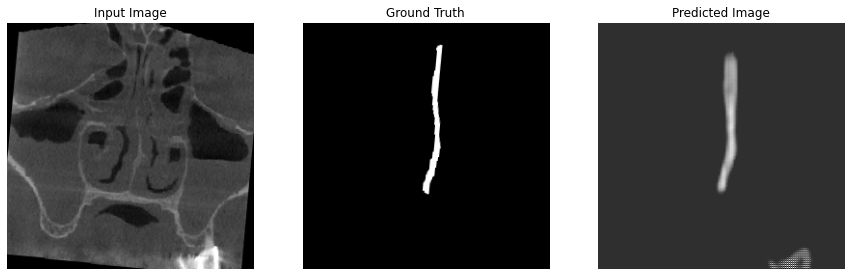

Epoch:  16
Done 59/60
Time taken for epoch 17 is 76.70803928375244 sec

(1, 256, 256, 1)


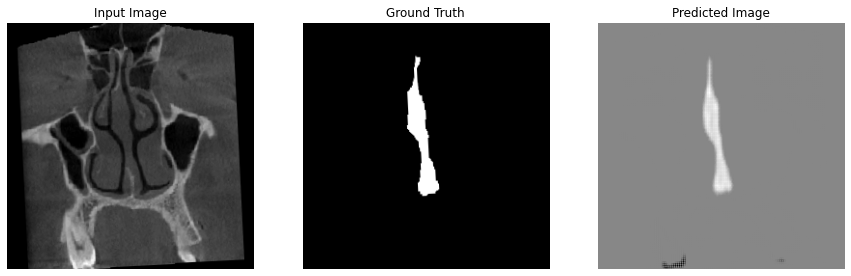

Epoch:  17
Done 59/60
Time taken for epoch 18 is 78.22546434402466 sec

(1, 256, 256, 1)


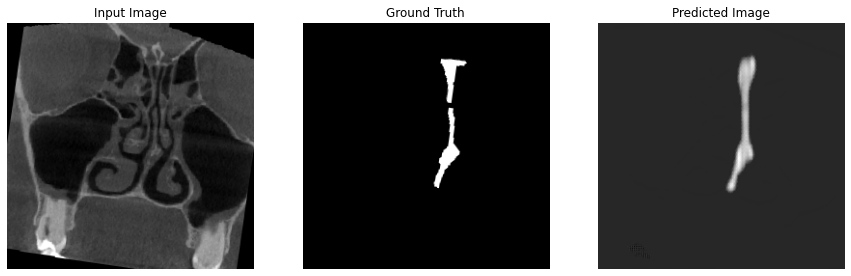

Epoch:  18
Done 59/60
Time taken for epoch 19 is 77.35198307037354 sec

(1, 256, 256, 1)


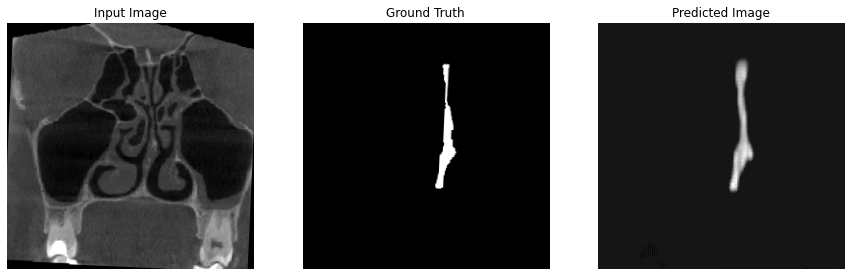

Epoch:  19
Done 59/60
Time taken for epoch 20 is 78.90836191177368 sec

(1, 256, 256, 1)


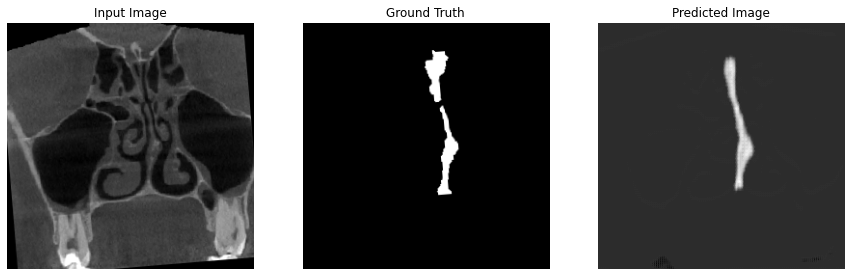

Epoch:  20
Done 59/60
Time taken for epoch 21 is 77.6134979724884 sec

(1, 256, 256, 1)


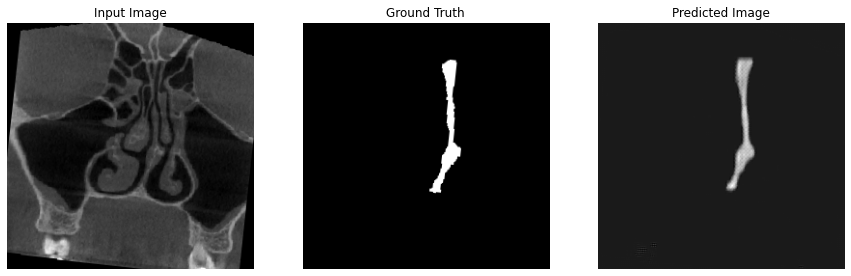

Epoch:  21
Done 59/60
Time taken for epoch 22 is 77.18806576728821 sec

(1, 256, 256, 1)


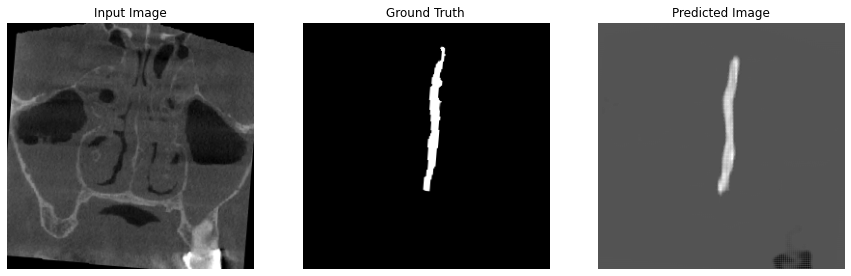

Epoch:  22
Done 59/60
Time taken for epoch 23 is 76.99261784553528 sec

(1, 256, 256, 1)


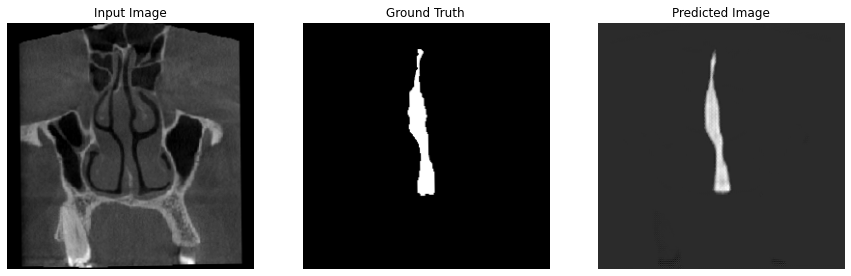

Epoch:  23
Done 59/60
Time taken for epoch 24 is 79.20360803604126 sec

(1, 256, 256, 1)


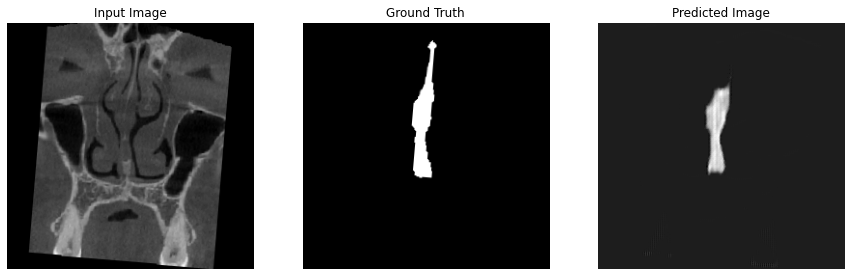

Epoch:  24
Done 59/60
Time taken for epoch 25 is 77.13937282562256 sec

(1, 256, 256, 1)


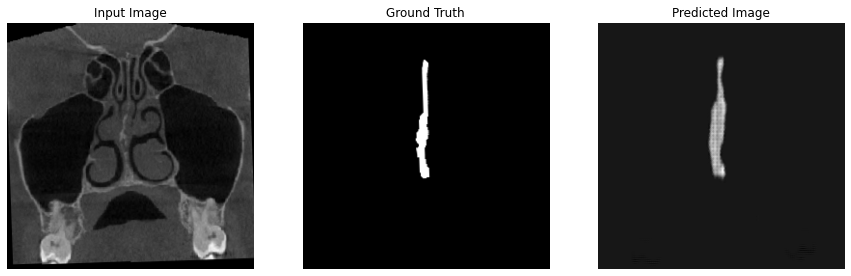

Epoch:  25
Done 59/60
Time taken for epoch 26 is 78.21684718132019 sec

(1, 256, 256, 1)


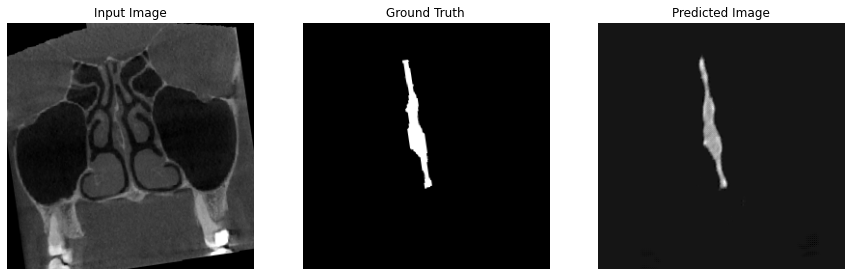

Epoch:  26
Done 59/60
Time taken for epoch 27 is 75.9052004814148 sec

(1, 256, 256, 1)


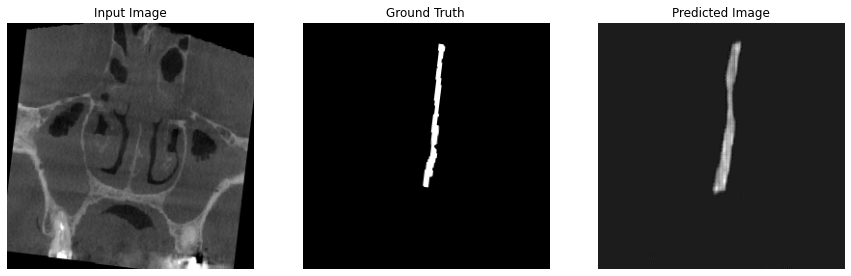

Epoch:  27
Done 59/60
Time taken for epoch 28 is 79.0297966003418 sec

(1, 256, 256, 1)


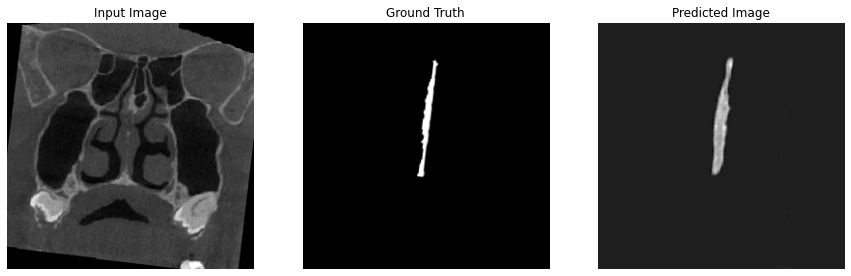

Epoch:  28
Done 59/60
Time taken for epoch 29 is 76.83458065986633 sec

(1, 256, 256, 1)


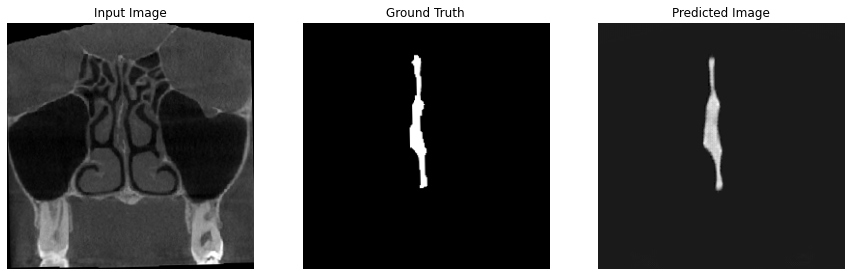

Epoch:  29
Done 59/60
Time taken for epoch 30 is 78.21794319152832 sec

(1, 256, 256, 1)


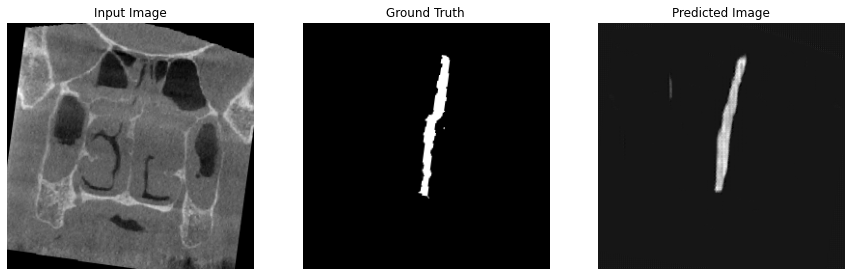

Epoch:  30
Done 59/60
Time taken for epoch 31 is 77.67852520942688 sec

(1, 256, 256, 1)


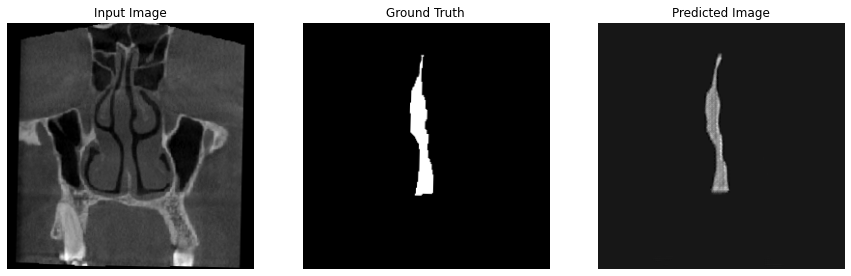

Epoch:  31
Done 59/60
Time taken for epoch 32 is 78.425288438797 sec

(1, 256, 256, 1)


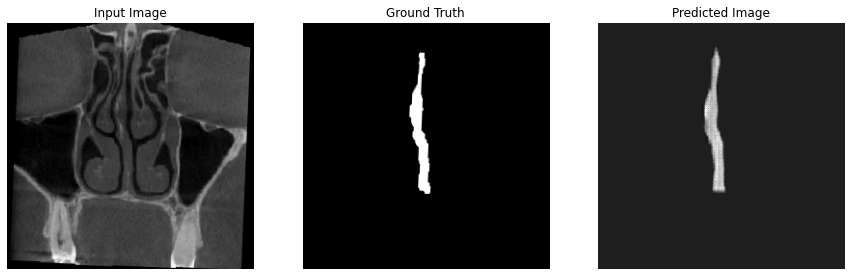

Epoch:  32
Done 59/60
Time taken for epoch 33 is 77.50790739059448 sec

(1, 256, 256, 1)


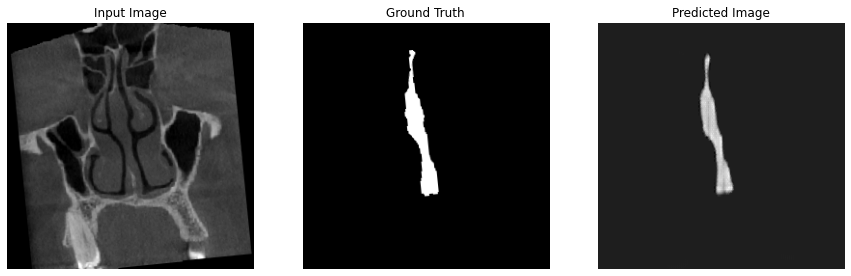

Epoch:  33
Done 59/60
Time taken for epoch 34 is 76.80545473098755 sec

(1, 256, 256, 1)


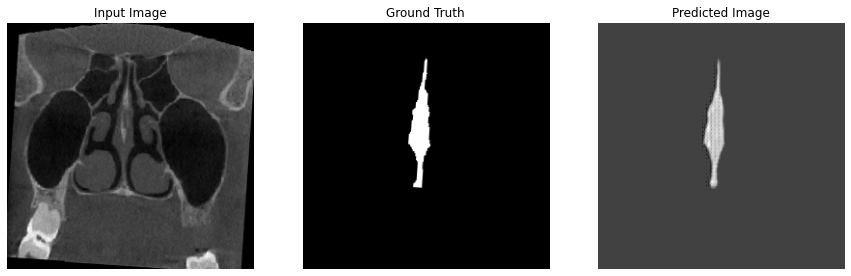

Epoch:  34
Done 59/60
Time taken for epoch 35 is 76.9389021396637 sec

(1, 256, 256, 1)


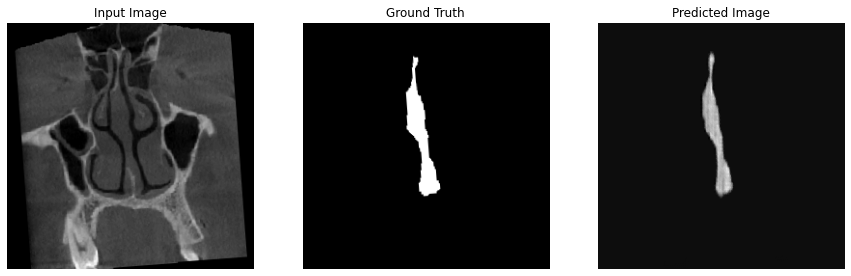

Epoch:  35
Done 59/60
Time taken for epoch 36 is 79.68580436706543 sec

(1, 256, 256, 1)


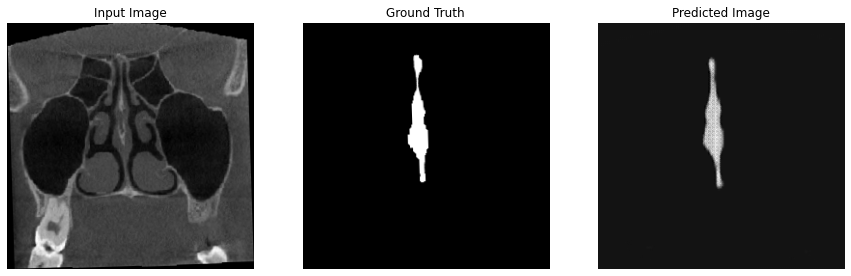

Epoch:  36
Done 59/60
Time taken for epoch 37 is 77.753169298172 sec

(1, 256, 256, 1)


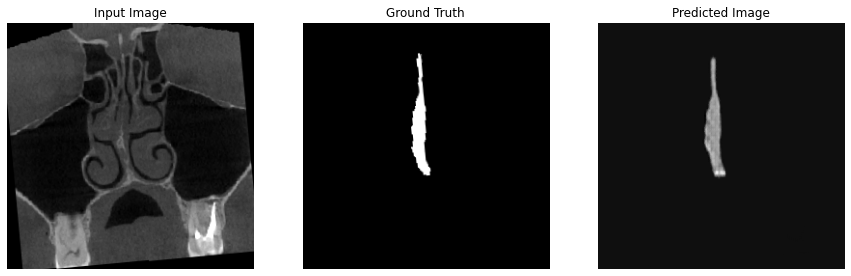

Epoch:  37
Done 59/60
Time taken for epoch 38 is 77.43153643608093 sec

(1, 256, 256, 1)


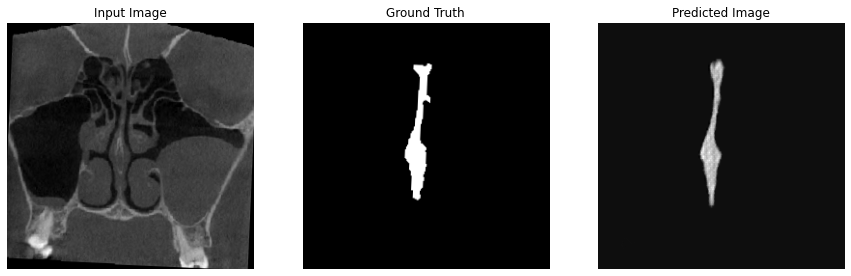

Epoch:  38
Done 59/60
Time taken for epoch 39 is 77.2604250907898 sec

(1, 256, 256, 1)


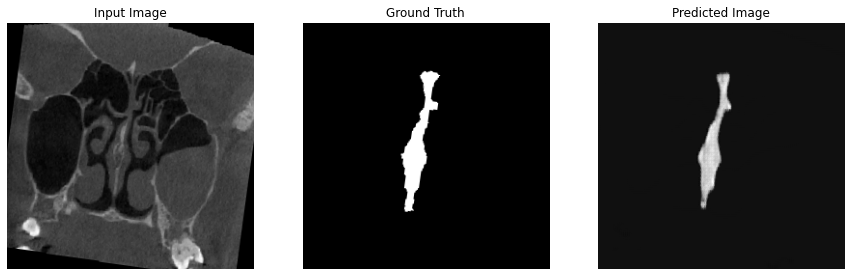

Epoch:  39
Done 59/60
Time taken for epoch 40 is 78.6999351978302 sec

(1, 256, 256, 1)


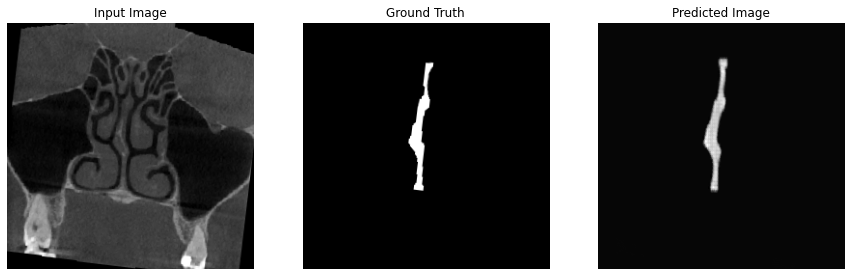

Epoch:  40
Done 59/60
Time taken for epoch 41 is 77.49005031585693 sec

(1, 256, 256, 1)


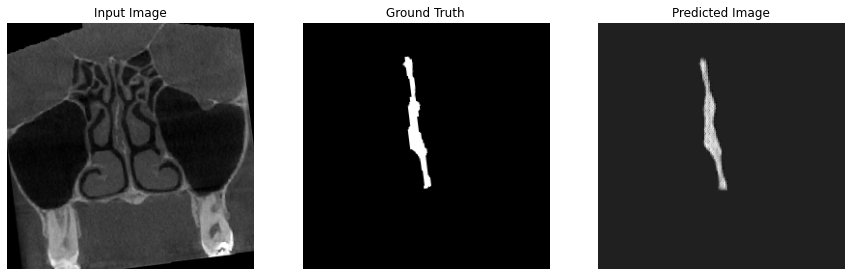

Epoch:  41
Done 59/60
Time taken for epoch 42 is 77.63549613952637 sec

(1, 256, 256, 1)


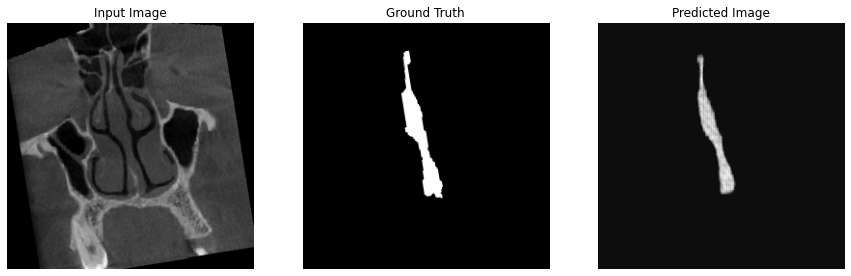

Epoch:  42
Done 59/60
Time taken for epoch 43 is 76.95132660865784 sec

(1, 256, 256, 1)


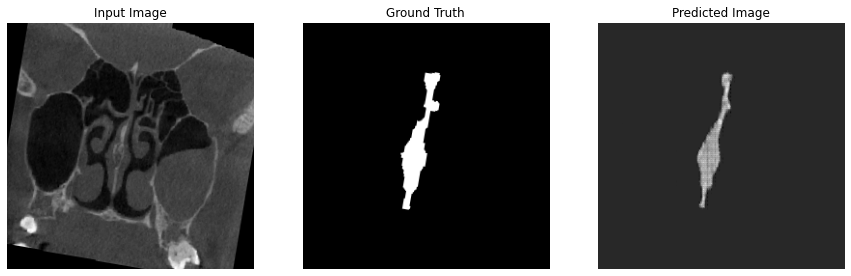

Epoch:  43
Done 59/60
Time taken for epoch 44 is 78.84333992004395 sec

(1, 256, 256, 1)


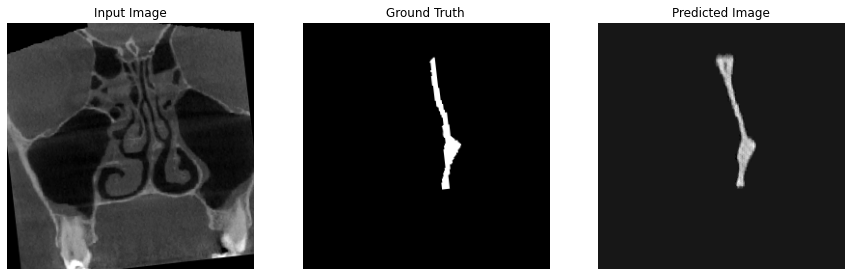

Epoch:  44
Done 59/60
Time taken for epoch 45 is 77.8594810962677 sec

(1, 256, 256, 1)


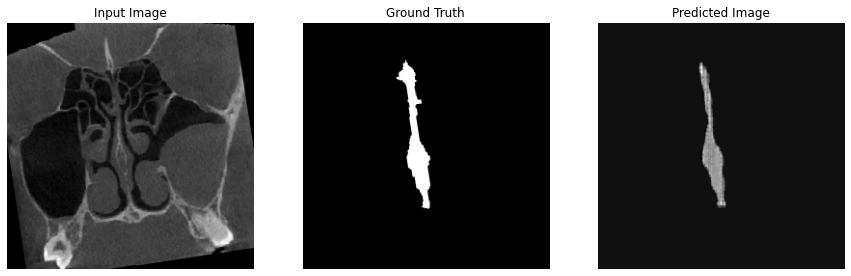

Epoch:  45
Done 59/60
Time taken for epoch 46 is 77.9055745601654 sec

(1, 256, 256, 1)


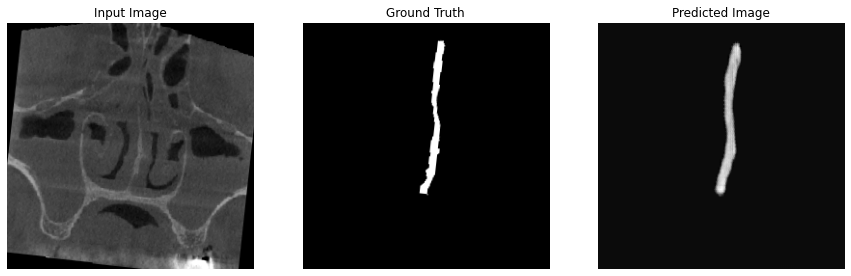

Epoch:  46
Done 59/60
Time taken for epoch 47 is 78.54005861282349 sec

(1, 256, 256, 1)


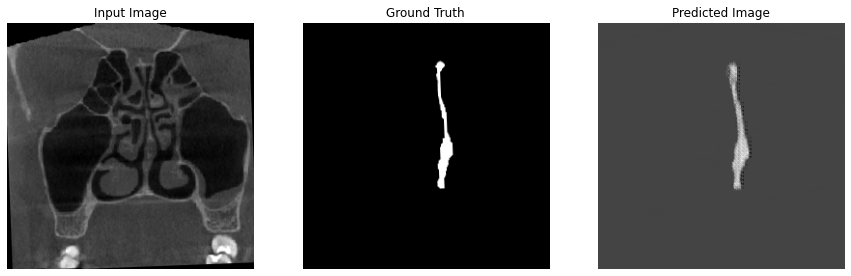

Epoch:  47
Done 59/60
Time taken for epoch 48 is 78.89292359352112 sec

(1, 256, 256, 1)


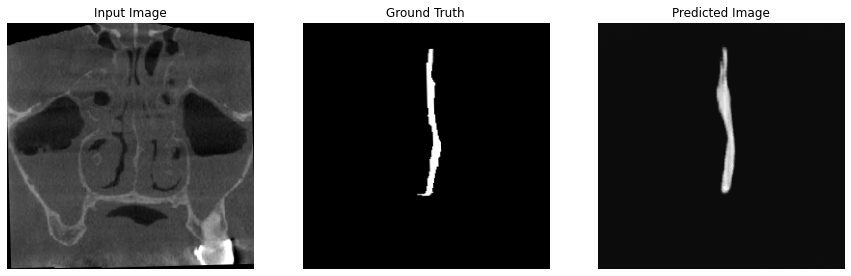

Epoch:  48
Done 59/60
Time taken for epoch 49 is 77.87681746482849 sec

(1, 256, 256, 1)


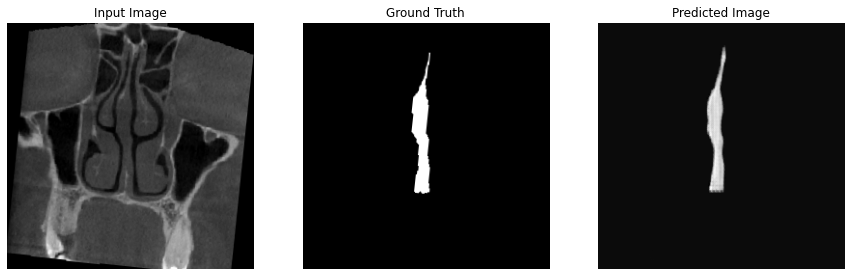

Epoch:  49
Done 59/60
Time taken for epoch 50 is 78.0591127872467 sec

(1, 256, 256, 1)


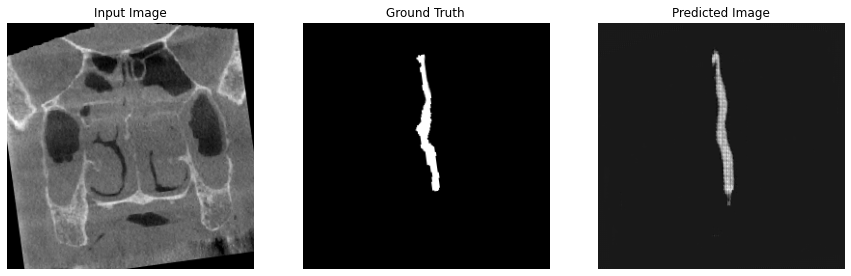

Epoch:  50
Done 59/60
Time taken for epoch 51 is 77.4547507762909 sec

(1, 256, 256, 1)


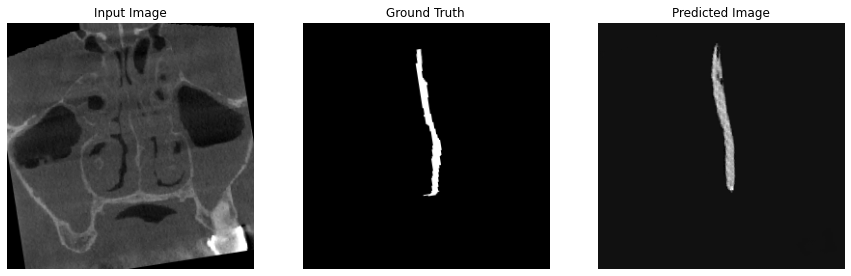

Epoch:  51
Done 1/60

KeyboardInterrupt: ignored

In [ ]:
import time
from IPython import display
 
fit(EPOCHS, STEP_PER_EPOCH, train_generator)

(1, 256, 256, 1)


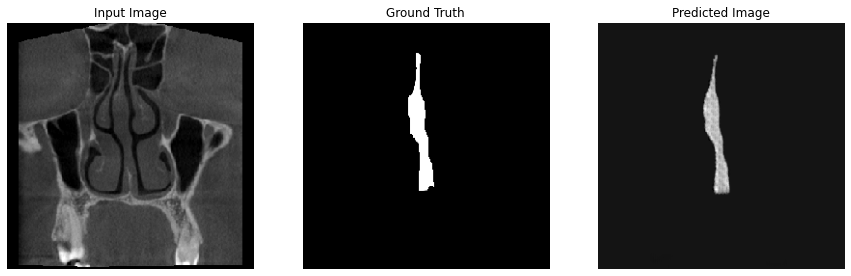

(1, 256, 256, 1)


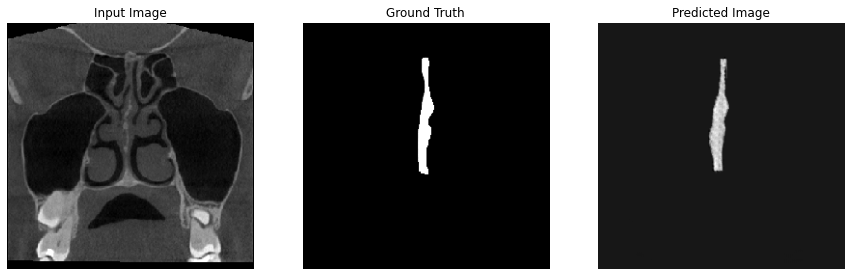

(1, 256, 256, 1)


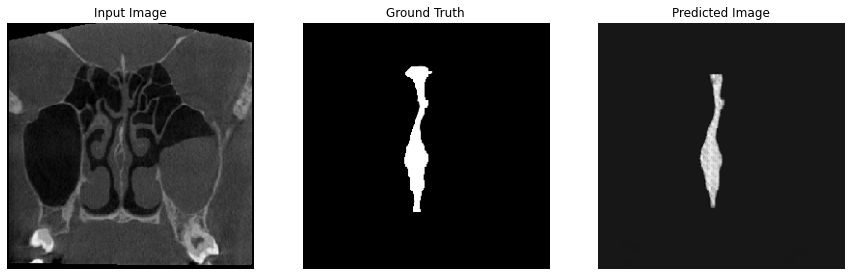

(1, 256, 256, 1)


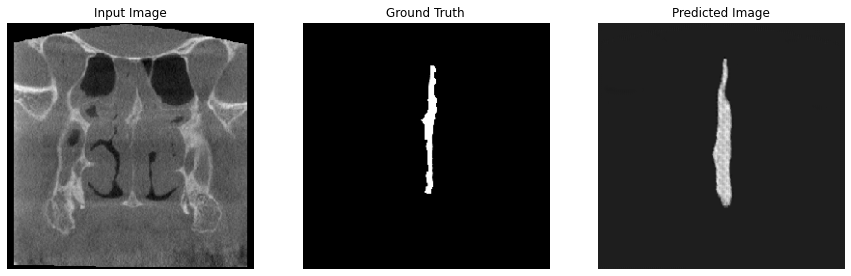

(1, 256, 256, 1)


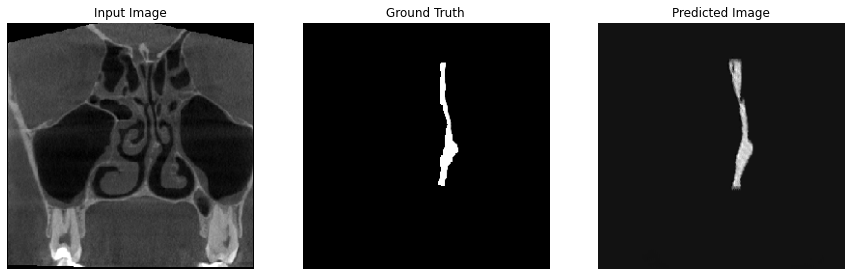

(1, 256, 256, 1)


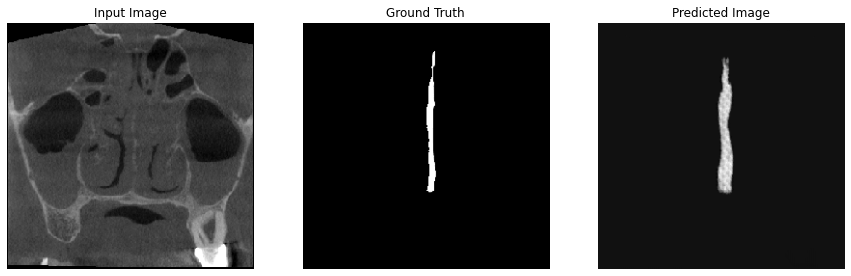

(1, 256, 256, 1)


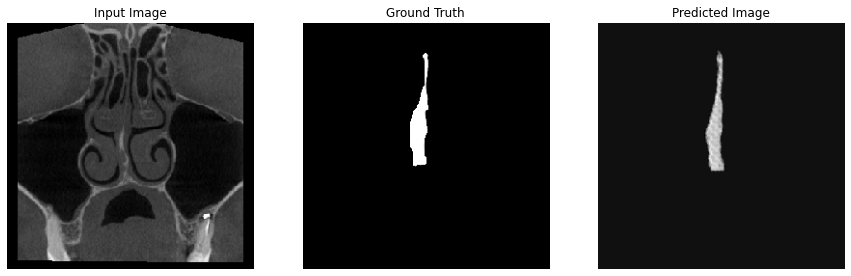

(1, 256, 256, 1)


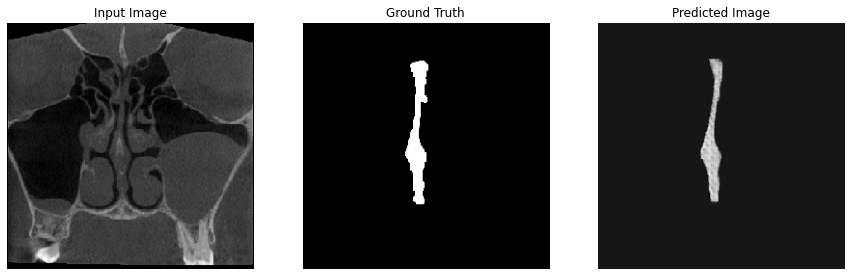

(1, 256, 256, 1)


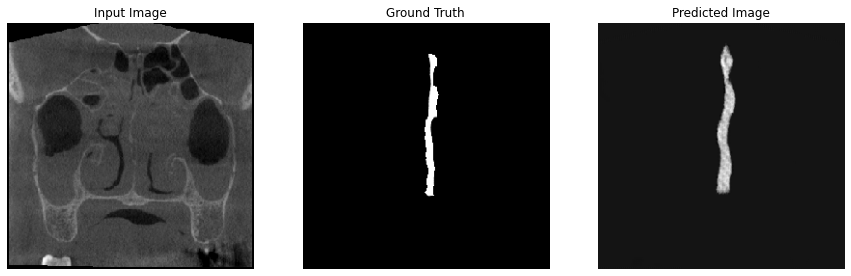

(1, 256, 256, 1)


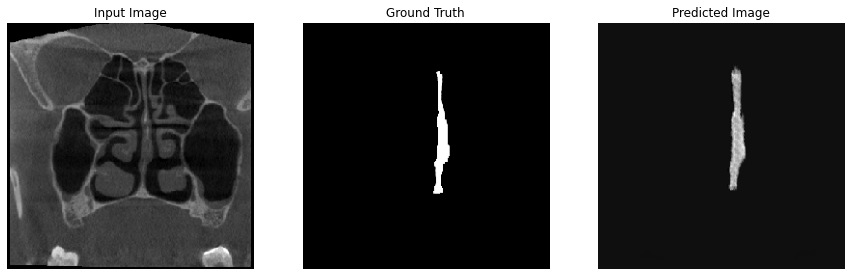

(1, 256, 256, 1)


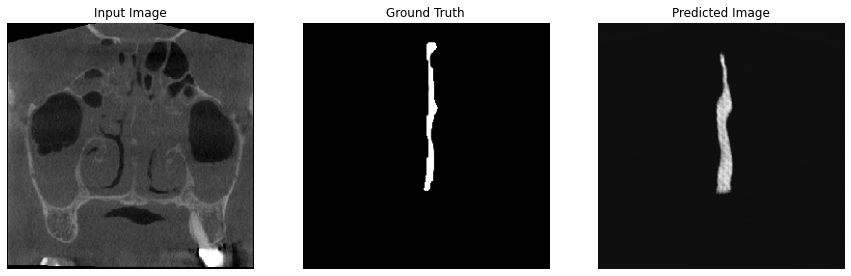

(1, 256, 256, 1)


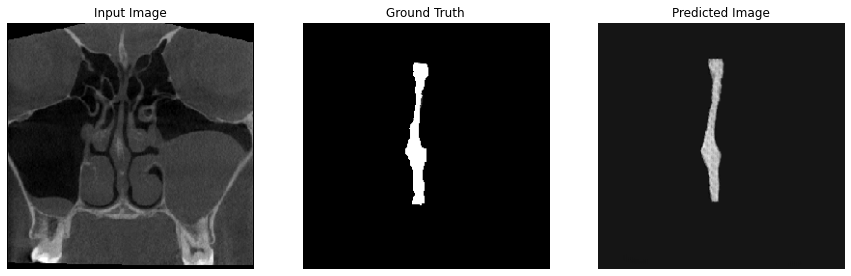

(1, 256, 256, 1)


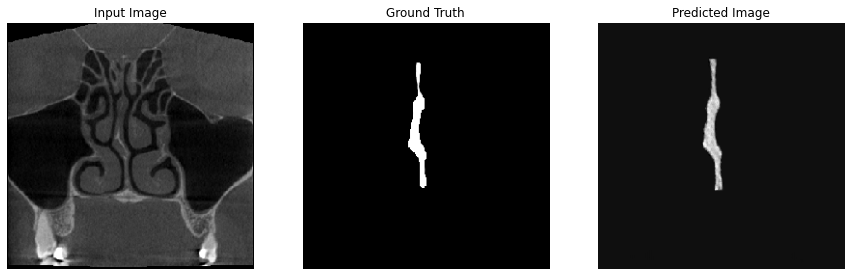

(1, 256, 256, 1)


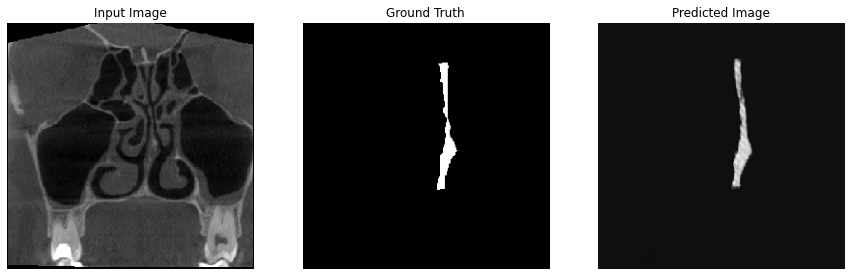

(1, 256, 256, 1)


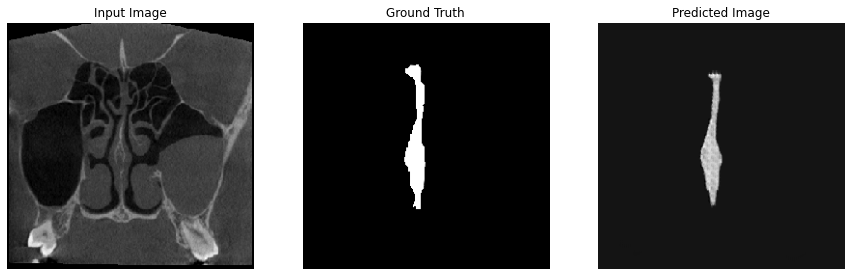

(1, 256, 256, 1)


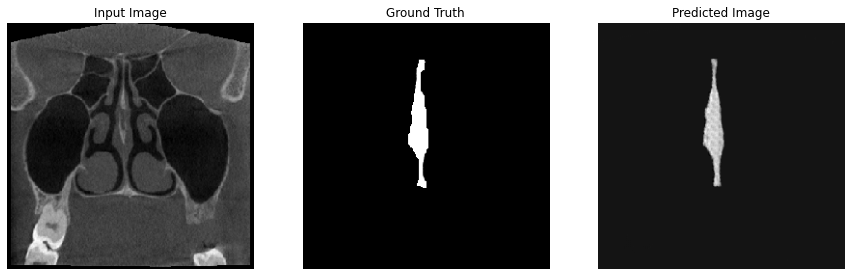

(1, 256, 256, 1)


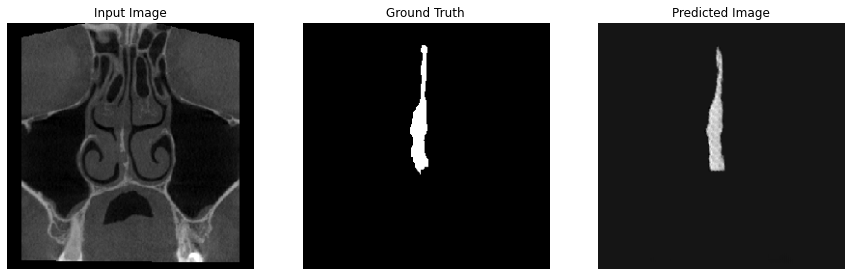

(1, 256, 256, 1)


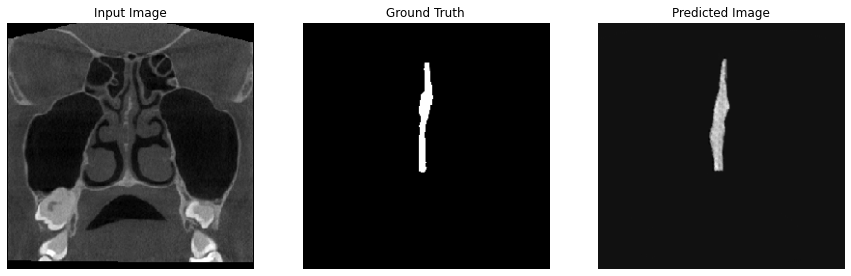

(1, 256, 256, 1)


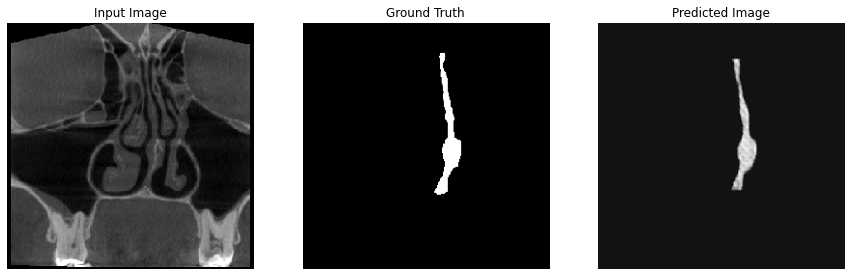

(1, 256, 256, 1)


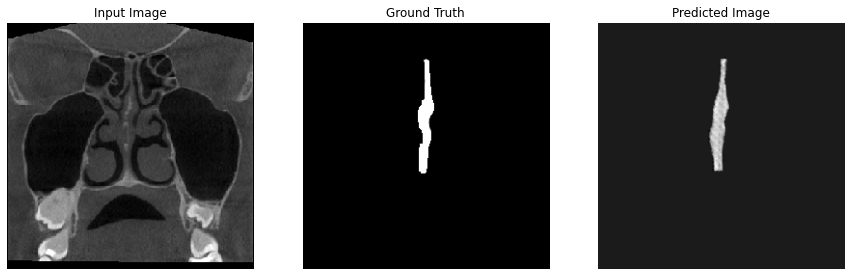

(1, 256, 256, 1)


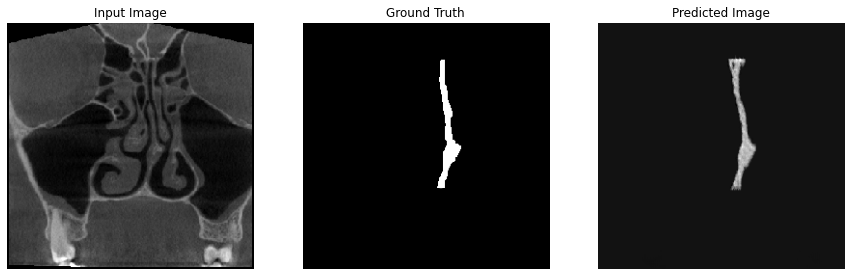

(1, 256, 256, 1)


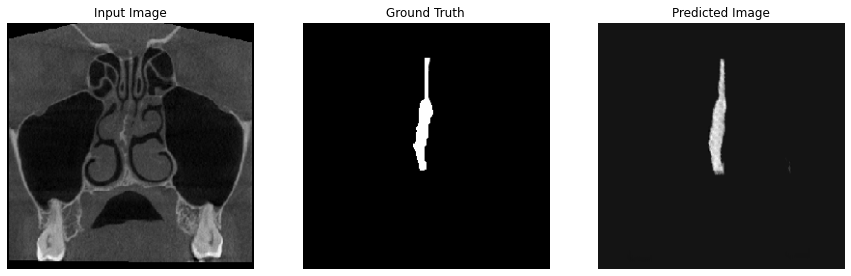

(1, 256, 256, 1)


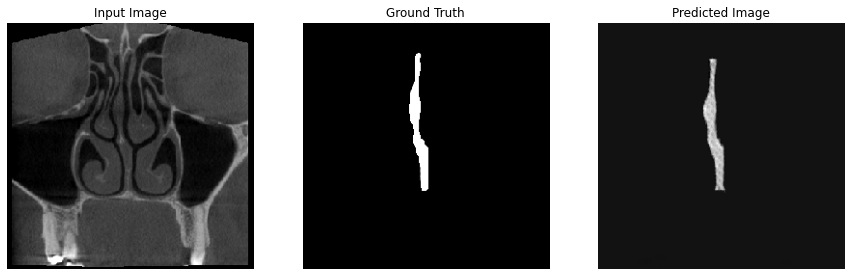

(1, 256, 256, 1)


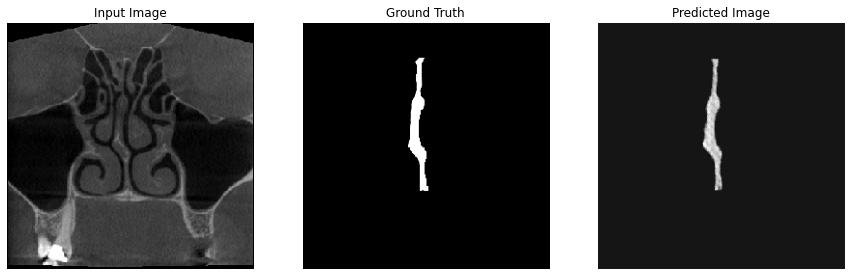

(1, 256, 256, 1)


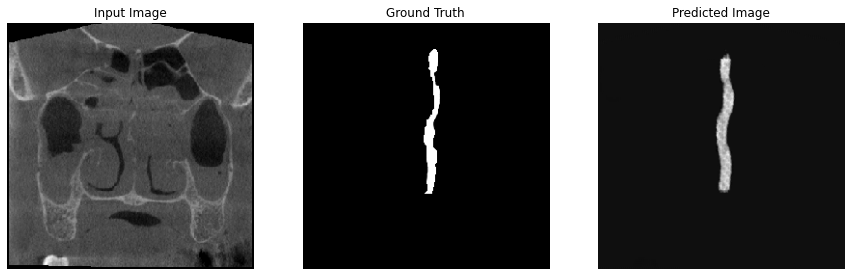

(1, 256, 256, 1)


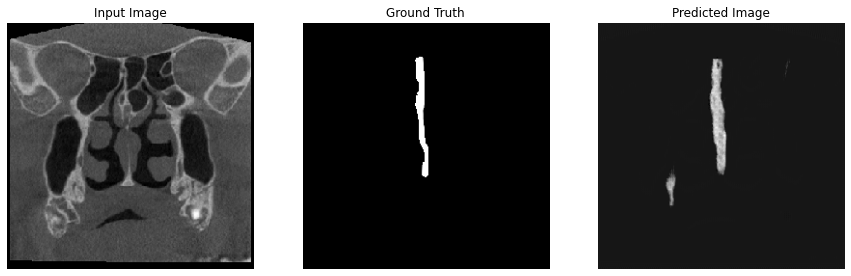

(1, 256, 256, 1)


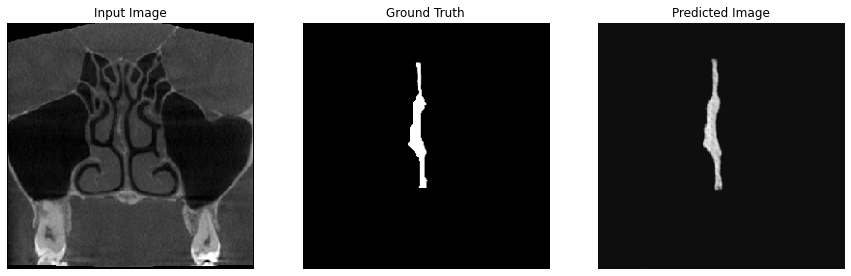

(1, 256, 256, 1)


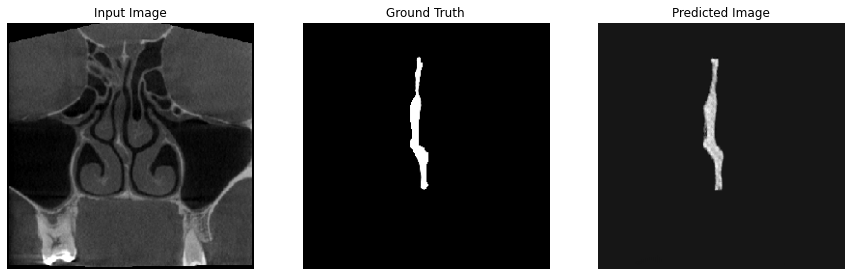

(1, 256, 256, 1)


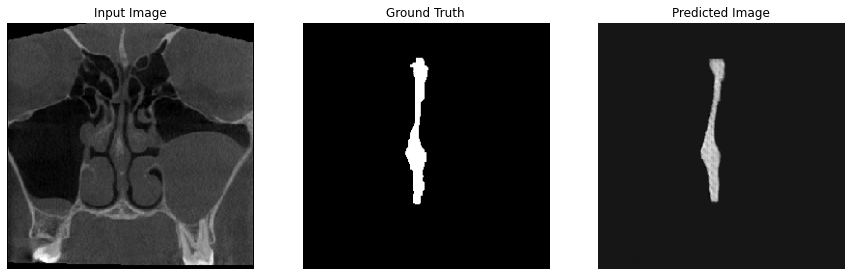

(1, 256, 256, 1)


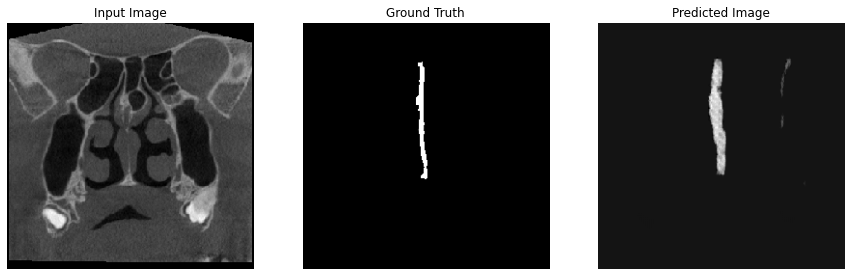

(1, 256, 256, 1)


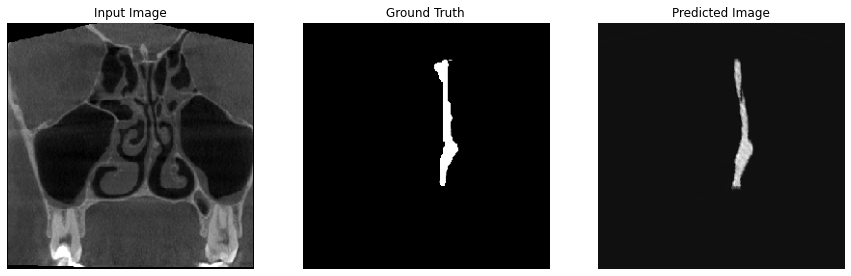

(1, 256, 256, 1)


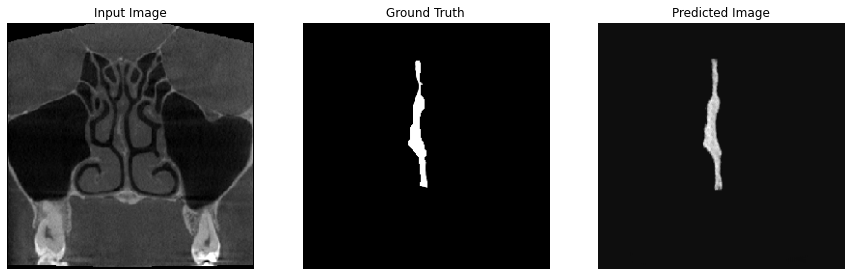

In [ ]:
test_frames, test_masks = next(test_generator)

for frame, mask in zip(test_frames, test_masks):
  generate_images(generator, frame, mask)

Saving weights to google drive

In [ ]:
discriminator.save('./drive/My Drive/Models/model_septum_mobilenetV2_discriminator_50.h5')
generator.save('./drive/My Drive/Models/model_septum_mobilenetV2_generator_50.h5')

In [ ]:
def save_image(model, test_input, name):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15,15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.savefig(DATA_PATH +'/predicted/' + name + '.png')

In [ ]:
val_frames_root = Path(DATA_PATH+'/val_frames/frames')
val_frames_path = sorted([str(path) for path in test_frames_root.iterdir()])

val_masks_root = Path(DATA_PATH+'/val_masks/masks')
val_mask_path = sorted([str(path) for path in test_masks_root.iterdir()])

val_frames, val_masks = create_dataset(val_frames_path, val_mask_path)

print(val_frames_path[0:9])
print(val_mask_path[0:9])

val_frames_ds = tf.data.Dataset.from_tensor_slices(val_frames)
val_masks_ds = tf.data.Dataset.from_tensor_slices(val_masks)
val_ds = tf.data.Dataset.zip((val_frames_ds, val_masks_ds ))


val_ds = val_ds.batch(BATCH_SIZE)

['drive/My Drive/Datasets/images/Septum/test_frames/frames/003-170.png', 'drive/My Drive/Datasets/images/Septum/test_frames/frames/003-184.png', 'drive/My Drive/Datasets/images/Septum/test_frames/frames/003-187.png', 'drive/My Drive/Datasets/images/Septum/test_frames/frames/003-203.png', 'drive/My Drive/Datasets/images/Septum/test_frames/frames/003-206.png', 'drive/My Drive/Datasets/images/Septum/test_frames/frames/003-208.png', 'drive/My Drive/Datasets/images/Septum/test_frames/frames/003-211.png', 'drive/My Drive/Datasets/images/Septum/test_frames/frames/003-217.png', 'drive/My Drive/Datasets/images/Septum/test_frames/frames/003-222.png']
['drive/My Drive/Datasets/images/Septum/test_masks/masks/003-170.png', 'drive/My Drive/Datasets/images/Septum/test_masks/masks/003-184.png', 'drive/My Drive/Datasets/images/Septum/test_masks/masks/003-187.png', 'drive/My Drive/Datasets/images/Septum/test_masks/masks/003-203.png', 'drive/My Drive/Datasets/images/Septum/test_masks/masks/003-206.png', 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


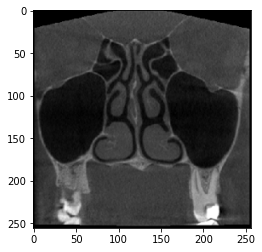

In [ ]:
name = 0

for inp, tar in val_ds.take(200):
  prediction = generator(inp, training=True)
  name += 1
  plt.imshow(prediction[0, :, :, :])
  plt.savefig(DATA_PATH +'/predicted/' + str(name) + ' predicted' '.png')
  plt.imshow(inp[0, :, :, :])
  plt.savefig(DATA_PATH +'/predicted/' + str(name) + ' start' '.png')